In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import seaborn as sns
import heapq
import csv
import sys
from copy import copy
import os 
module_path = os.path.abspath(os.path.join('../../RL_algorithms'))
sys.path.insert(0, module_path)
from Utils import tsplot, find_filenames_with_extension
from tqdm import tqdm
from scipy.stats import kendalltau
import matplotlib.patches as mpatches
import itertools
import heapq
plt.rcParams.update({'font.size': 16})

In [5]:
def kendall_with_pval(x,y):
    return kendalltau(x,y)

BASE = "../saved_reward_fn_performances/AAAI_Experiments/"

HYPERPARAM_LOCS = ["QLearnAlpha0pt25",
                   "QLearnBaseline",
                   "QLearnGamma0pt8",
                   "QLearnGamma0pt5"
]

DEEP_LOCS = ["UserRewardFnReRunWithDefaultParams/PPO",
             "UserRewardFnReRunWithDefaultParams/A2C",
             "UserRewardFnReRunWithDefaultParams/DDQN",
             "UserRewardFnReRunWithDefaultParams/Q_Learn"]

DIR_LABELS = {"QLearnAlpha0pt25": "Alpha=0.25",
              "QLearnBaseline": "Baseline",
              "QLearnGamma0pt8": "Gamma=0.8",
              "QLearnGamma0pt5": "Gamma=0.5",
              "UserRewardFnReRunWithDefaultParams/PPO": "PPO",
              "UserRewardFnReRunWithDefaultParams/A2C": "A2C",
              "UserRewardFnReRunWithDefaultParams/DDQN": "DDQN",
              "UserRewardFnReRunWithDefaultParams/Q_Learn": "QLearn"
              }

In [23]:
###############
## Set DIR_LOCS to DEEP_LOCS for deep rl comparions, or to HYPERPARAM_LOCS for hyperparam comparisons
###############
DIRS_LOCS = HYPERPARAM_LOCS

In [24]:
def read_csv_into_heapq(h, csv_filename, line_limit=10):
    """
    Read csv into a heapq

    heapq documentation: https://docs.python.org/3/library/heapq.html
    :param heapq: h
    :param csv_filename: string
    :param line_limit: int, the number of trials to read in 
    :return: heapq
    """
    csv_file = open(csv_filename, "r")
    csv_reader = csv.reader(csv_file, delimiter=',')
    hyper_params = next(csv_reader)  # gets the first line (which just records hyperparams)
    reward_fn = next(csv_reader) # gets the second line (which just records the reward fn)
    performance = []
    for idx, row in enumerate(csv_reader):
        if idx >= line_limit:
            continue
        running_total = 0
        row = [[running_total := running_total + eval(x)[0]-1] for x in row]  # subtract 1 since every ep starts -H
        performance.append(row)

    data = np.array(performance)
    if len(data.shape) == 3:
        data = np.concatenate(data, axis=-1)
        data = np.mean(data, axis=-1)
    heapq.heappush(h, (data[-1], str(reward_fn)))


In [25]:
li = []

DIRS = []
import os
print (os.getcwd())

for dir in DIRS_LOCS:
    h = []

    csv_files = find_filenames_with_extension(BASE + dir, "csv")
    for file in tqdm(csv_files):
        read_csv_into_heapq(h, BASE + dir + "/" + file)
    DIRS.append(DIR_LABELS[dir])
    df = pd.DataFrame(h, columns=[DIR_LABELS[dir], 'Reward Function'])
    li.append(df)
    del h

/home/serena/AAAI_23_reward_design/Experiments/plotting


100%|██████████████████████████████████████| 5196/5196 [06:20<00:00, 13.65it/s]


In [26]:
def get_max_diff_reward_fns(df, axes, junk_threshold=14000, num_to_highlight=9):
    """
    Save a .csv containing the top num_to_highlight reward functions for each combination
    """
         
    is_not_junk_reward_fn = np.logical_not(np.logical_and(df[axes[0]] < junk_threshold,
                                                          df[axes[1]] < junk_threshold))
    frame = df[is_not_junk_reward_fn]
    
    n_largest = frame.nlargest(num_to_highlight, "abs_diff_{}".format(axes), keep='first')
    max_diff_reward_fns = n_largest.sort_values(by="abs_diff_{}".format(axes), ascending=False)
    max_diff_reward_fns.to_csv("../saved_reward_fn_performances/AAAI_Experiments/TopDiffs/top_reward_fn_diffs_{}".format(axes))

In [27]:
def get_max_reward_fns(df, axis, num_to_highlight=9):
    """
    Save a .csv containing the top num_to_highlight reward functions for each combination
    """
         
    frame=df
    
    n_largest = frame.nlargest(num_to_highlight, axis, keep='first')
    max_reward_fns = n_largest.sort_values(by=axis, ascending=False)
    max_reward_fns.to_csv("../saved_reward_fn_performances/AAAI_Experiments/TopOverallFns/top_reward_fn_{}".format(axis))

In [28]:
def plot_parallel_coordinate(df, 
                             plotting_axes, 
                             highlight, 
                             labels=None, 
                             junk_threshold=14000, 
                             num_to_highlight=9,
                             y_lim=None):
    """
    """
    plt.rcParams.update({'font.size': 24})
    if labels is None: 
        labels = plotting_axes
        
    is_not_junk_reward_fn = np.logical_not(np.logical_and(df[plotting_axes[0]] < junk_threshold,
                                                          df[plotting_axes[1]] < junk_threshold))
    frame = df[is_not_junk_reward_fn]
    
    n_largest = frame.nlargest(num_to_highlight, highlight, keep='first')
    if plotting_axes[1] == highlight:
        n_largest = n_largest.sort_values(by=plotting_axes[1], ascending=False)
    else:
        n_largest = n_largest.sort_values(by=plotting_axes[0], ascending=False)

    fig = plt.figure(figsize=(10,10), dpi=160)
    plt.legend('', frameon=False)

    # plot all of the data with low opacity 
    pd.plotting.parallel_coordinates(frame,
                                     class_column="Reward Function",
                                     cols=[plotting_axes[0], plotting_axes[1]],
                                     color=np.array((0, 0, 0, 0.1)))
    
    # add num_to_highlight data with colors
    # be careful!!! manually overriding legend labels
    colors = []
    legend_labels = []
    for i in range(num_to_highlight):
        reward_fn = eval(n_largest.iloc[i]["Reward Function"])
        if type(eval(reward_fn[0])) is tuple: 
            reward_fn = [eval(x)[1] for x in reward_fn]
        else:
            reward_fn = [float(x) for x in reward_fn]
        color = color_cm(1. * i / (num_to_highlight - 1.0))
        legend_labels.append(mpatches.Patch(color=color,
                                            label="H ∧ T: {:7.2f}; H ∧ ¬T: {:7.2f}; ¬H ∧ T: {:7.2f}, ¬H ∧ ¬T: {:7.2f}".format(
                                                  reward_fn[0], reward_fn[1], 
                                                   reward_fn[2], reward_fn[3])))
        colors.append(color)

        df_tmp = pd.DataFrame(
            {
                plotting_axes[0]: [],
                plotting_axes[1]: [],
                "abs_diff": [],
                "Reward Function": []
            }
        )
        df_tmp.loc[0] = n_largest.iloc[i]
        pd.plotting.parallel_coordinates(df_tmp,
                                         class_column="Reward Function",
                                         cols=[plotting_axes[0], plotting_axes[1]],
                                         lw=5,
                                         color=color)
        
    plt.legend(handles=legend_labels,
           fontsize=20,
           bbox_to_anchor=(0.5, -0.1),
           loc='upper center',
           ncol=1,
           fancybox=True,
           shadow=True)
    
    # plot 
    plt.title("Relative Reward Function Performance\nfor {} and {}".format(labels[0], labels[1]),
              fontsize=20,
              pad=20)
    plt.ylabel("Cumulative True Reward", fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax_list = fig.axes
    ax_list[0].set_xticklabels(labels, fontsize=20)

    if y_lim is not None:
        plt.ylim(y_lim)
    plt.savefig('../../Plots/parallel_coord_{}_{}_{}.pdf'.format(plotting_axes[0], 
                                                                 plotting_axes[1],
                                                                 highlight), 
                bbox_inches='tight')
    plt.tight_layout()

    plt.show()

In [29]:
def compute_kendalls_tau_df(df, axes, junk_threshold=14000):
    """
    Compute kendall's tau 
    
    df: a pandas dataframe. Must have "Reward Function" as a column 
    axes: a list consisting of column names for comparison in 
    junk_threshold: int 
    """
    is_not_junk_reward_fn = np.logical_not(np.logical_and(cumulative_df[axes[0]] < junk_threshold,
                                                          cumulative_df[axes[1]] < junk_threshold))
    frame = cumulative_df[is_not_junk_reward_fn]
    
    kendalls_tau_value = kendalltau(frame.sort_values(by=[axes[0]], ascending=False)['Reward Function'],
                                    frame.sort_values(by=[axes[1]], ascending=False)['Reward Function'])
    return kendalls_tau_value

['$\\alpha$=0.25', '$\\alpha$=0.05']
Alpha=0.25 ;  Baseline :  KendalltauResult(correlation=0.1139656716601028, pvalue=1.2423168121390173e-06)


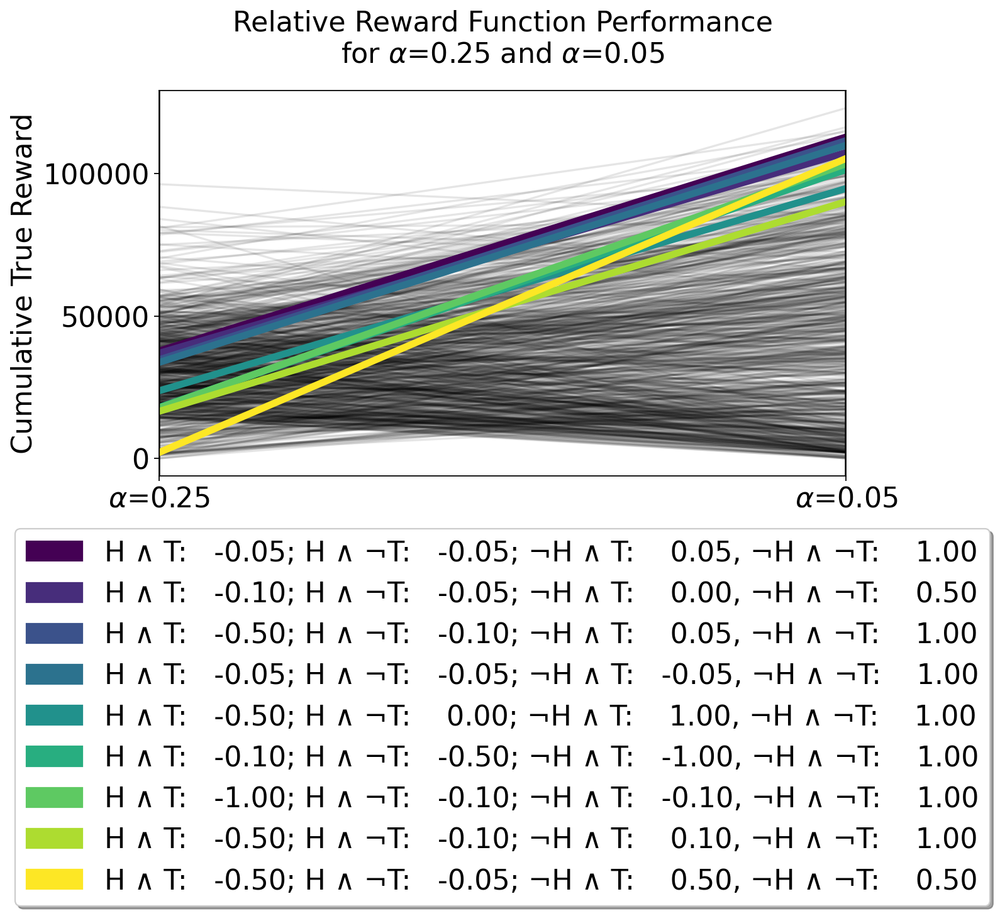

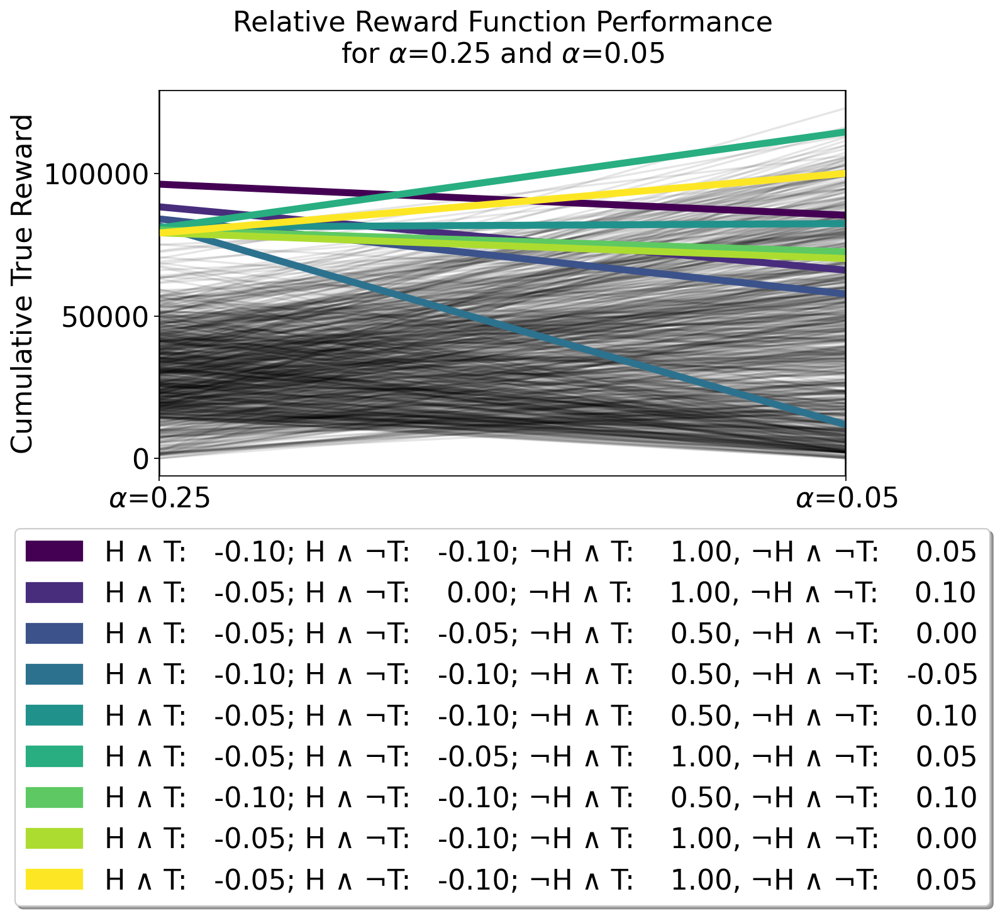

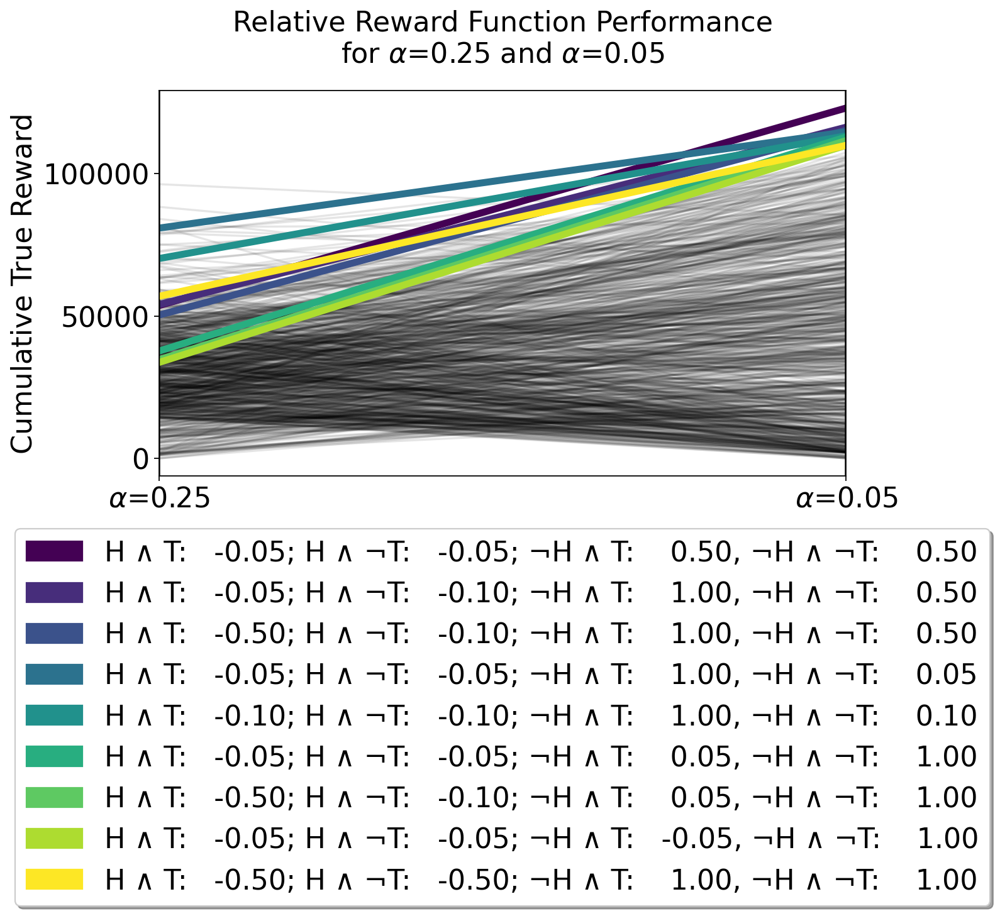

['$\\alpha$=0.25', '$\\gamma$=0.8']
Alpha=0.25 ;  Gamma=0.8 :  KendalltauResult(correlation=0.05941998250404262, pvalue=0.006050833826309645)


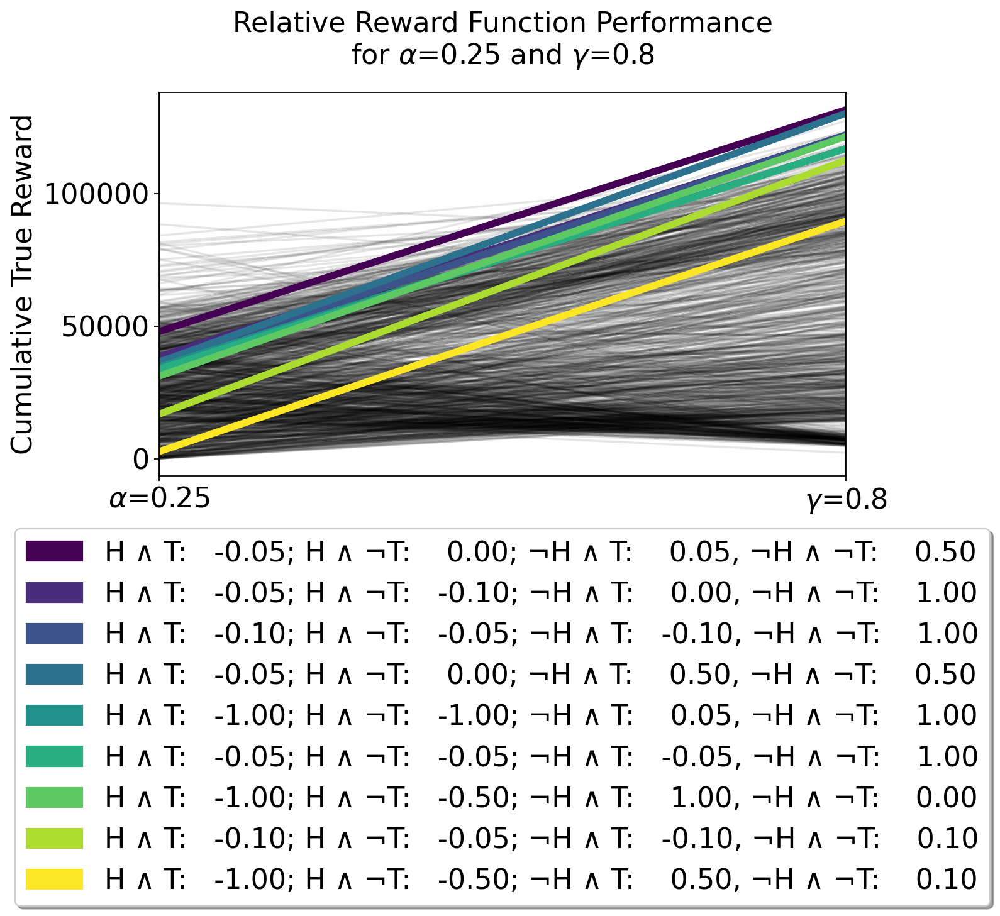

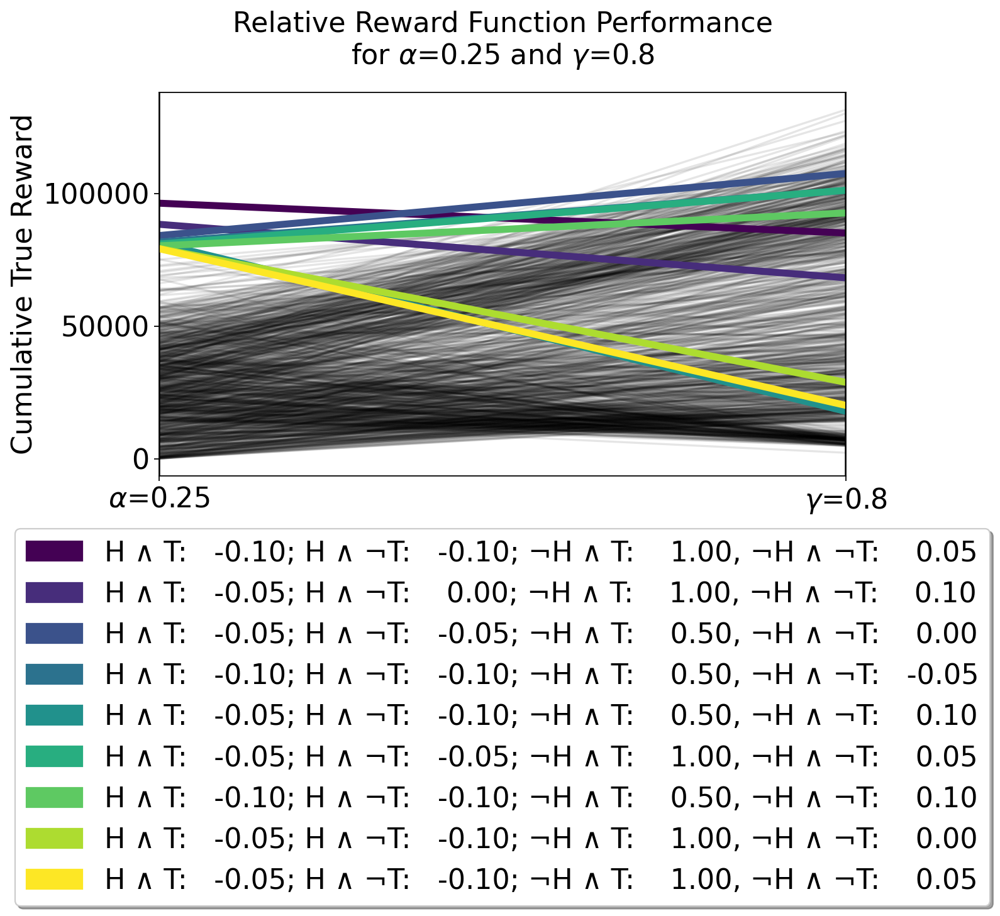

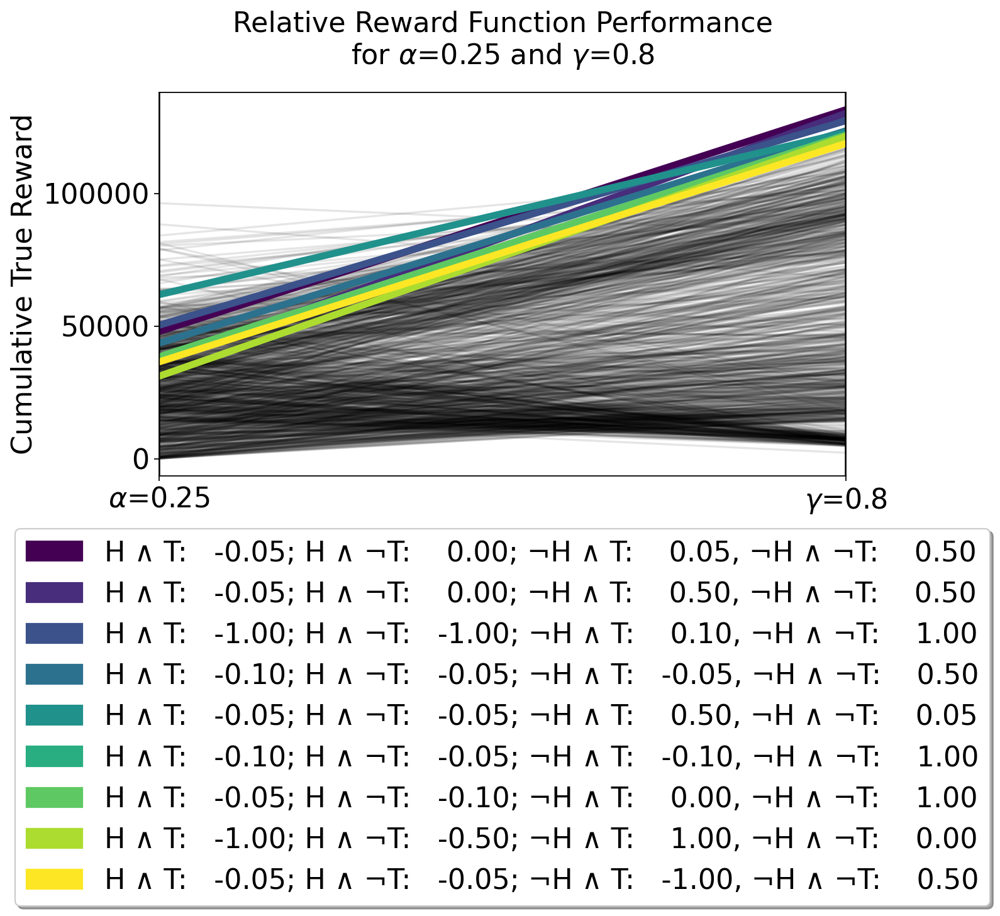

['$\\alpha$=0.25', '$\\gamma$=0.5']
Alpha=0.25 ;  Gamma=0.5 :  KendalltauResult(correlation=0.04888927181608008, pvalue=0.034459711445864204)


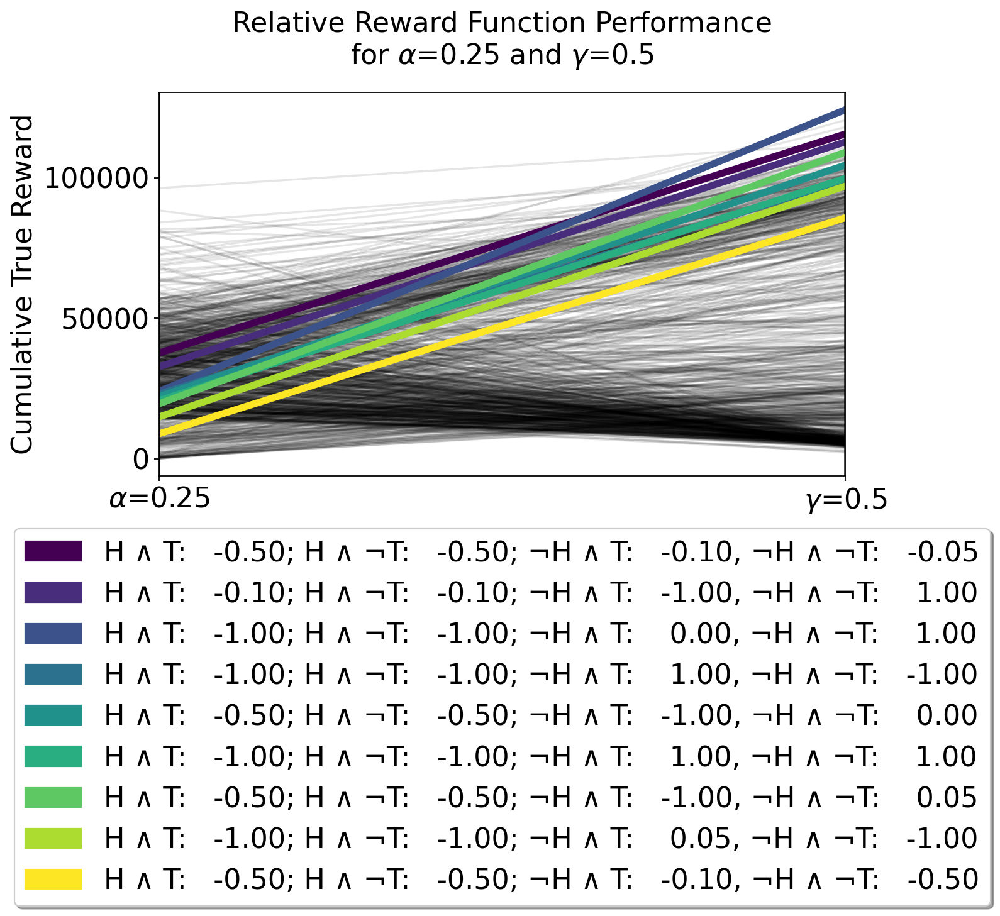

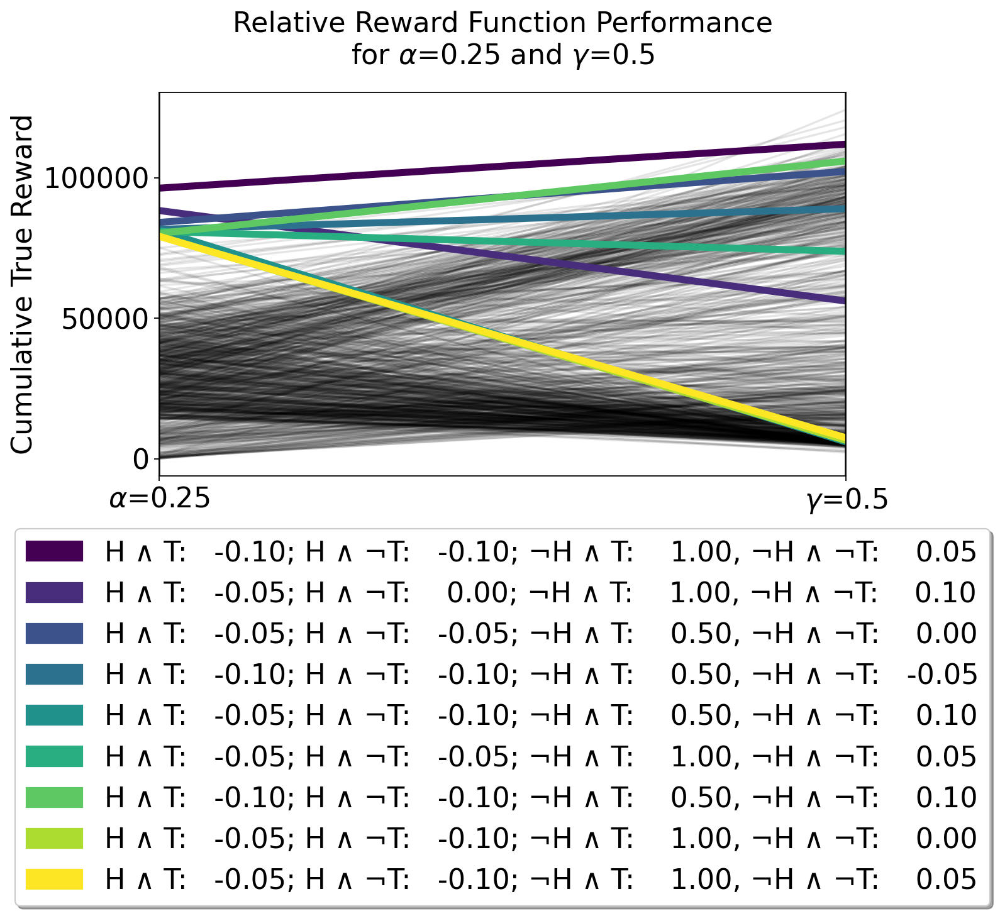

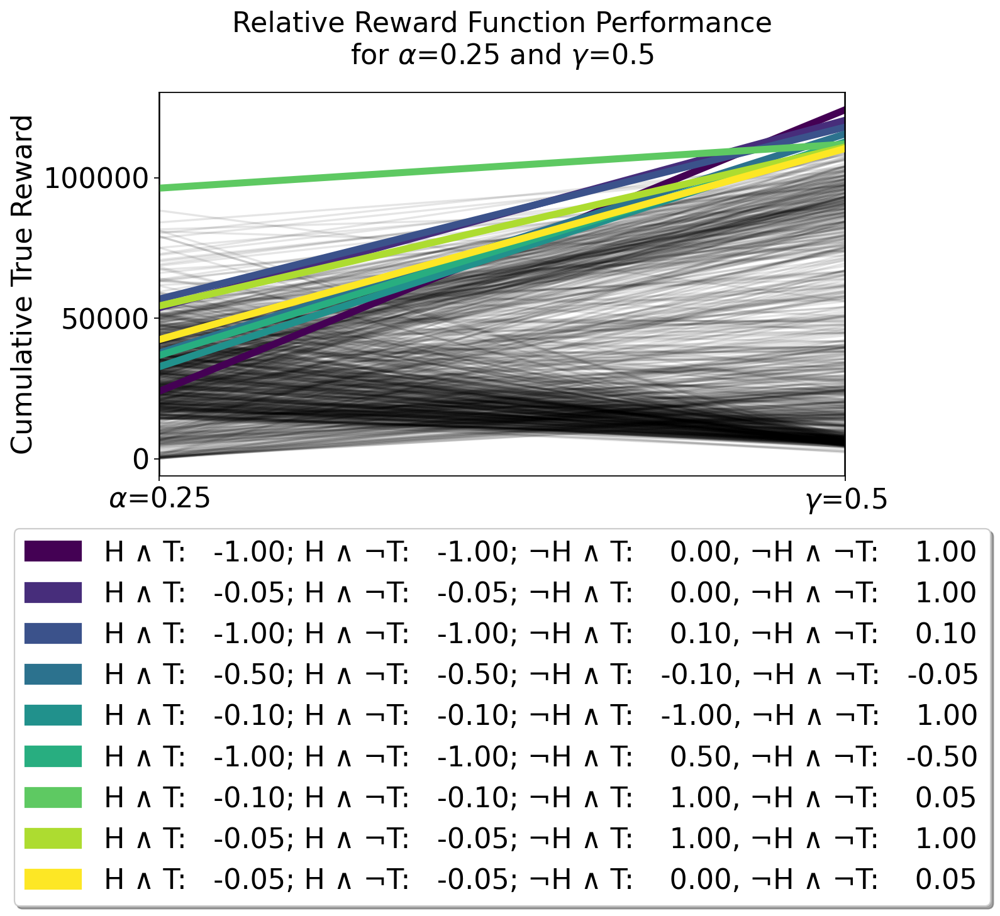

['$\\alpha$=0.05', '$\\alpha$=0.25']
Baseline ;  Alpha=0.25 :  KendalltauResult(correlation=0.1139656716601028, pvalue=1.2423168121390173e-06)


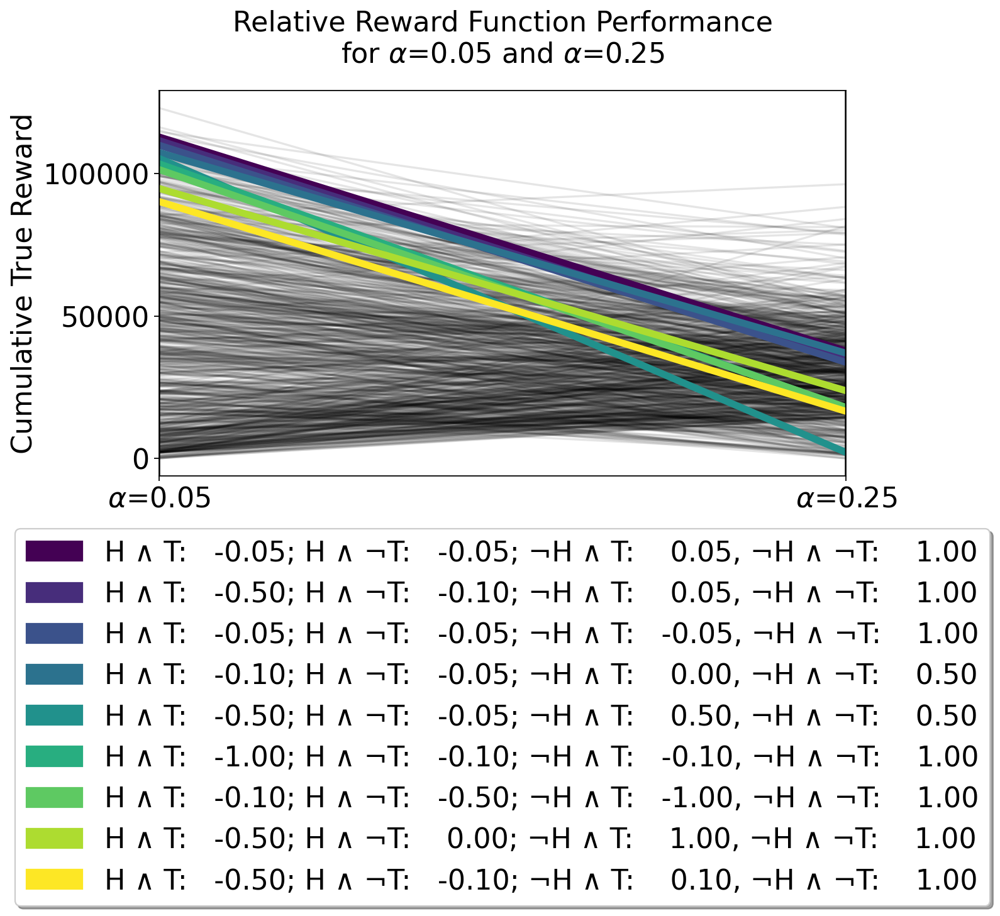

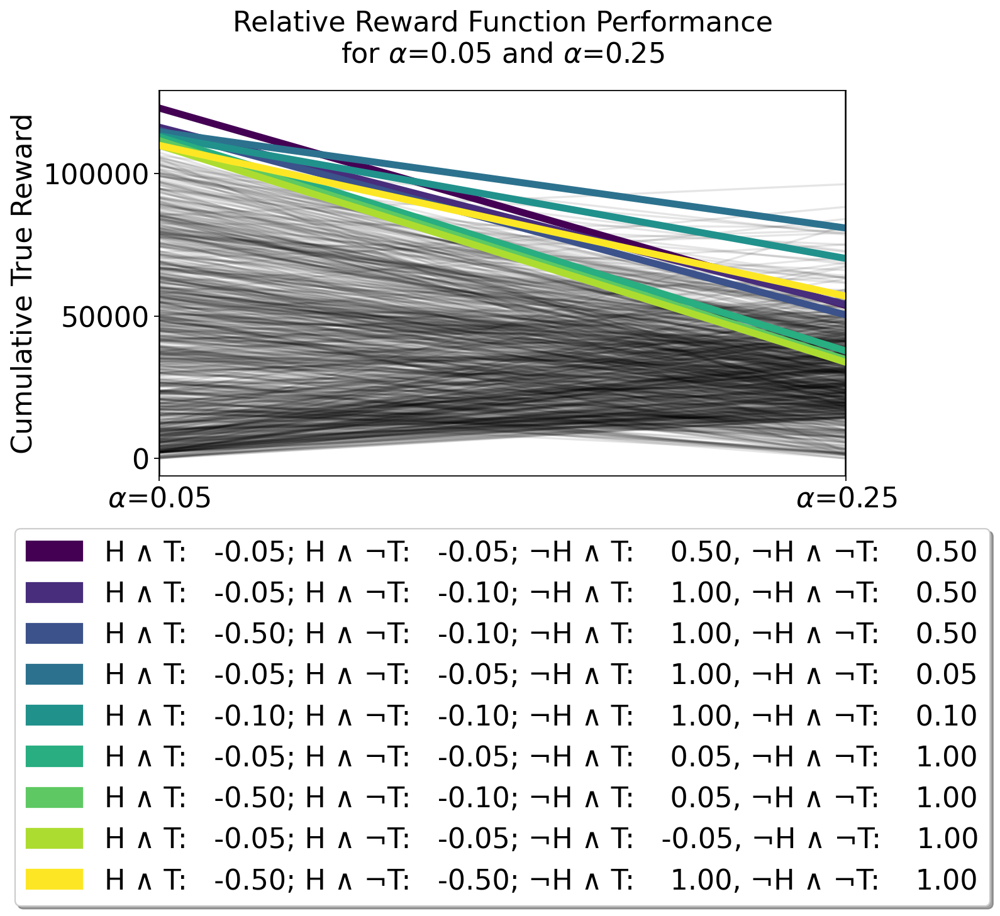

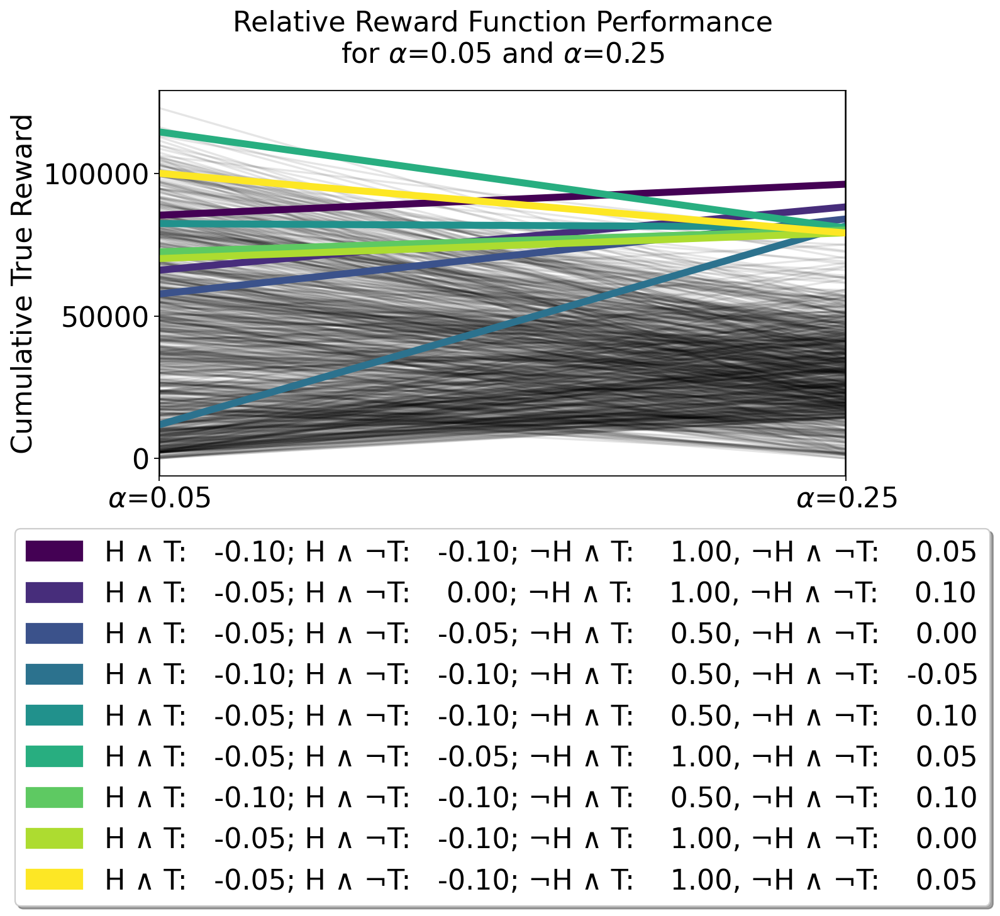

['$\\gamma$=0.99', '$\\gamma$=0.8']
Baseline ;  Gamma=0.8 :  KendalltauResult(correlation=0.06715811611046545, pvalue=0.001929626728481448)


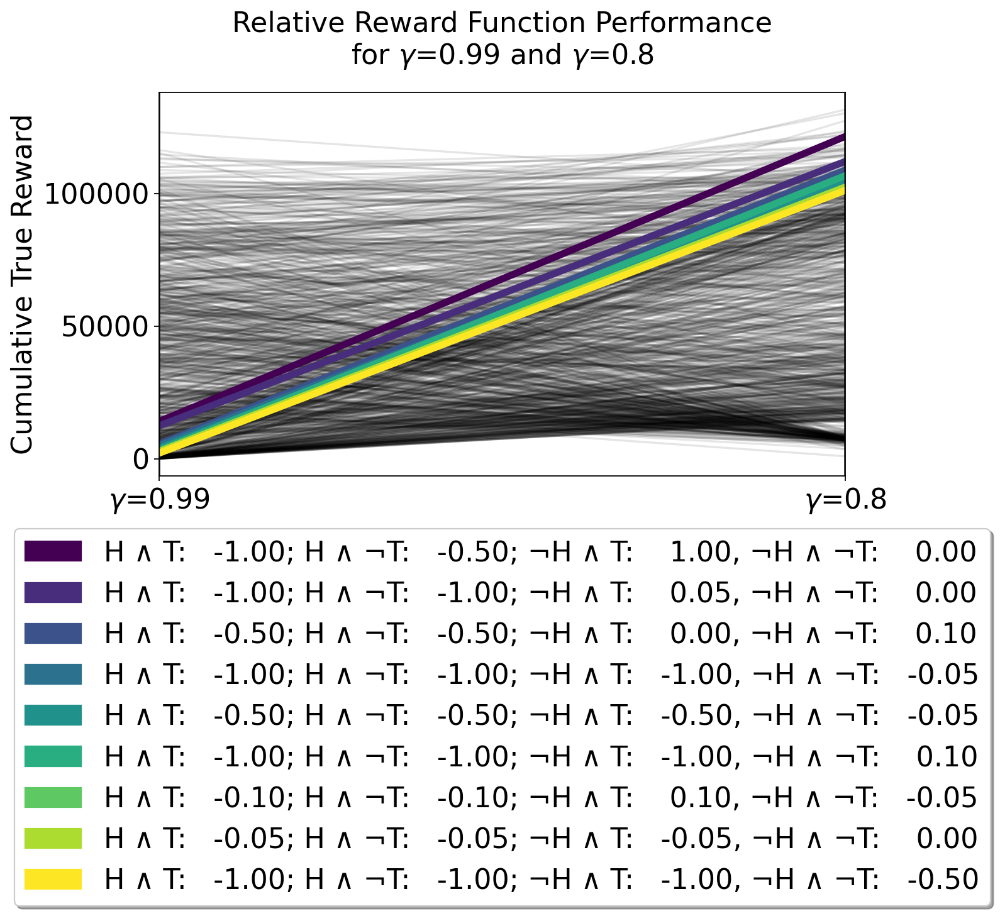

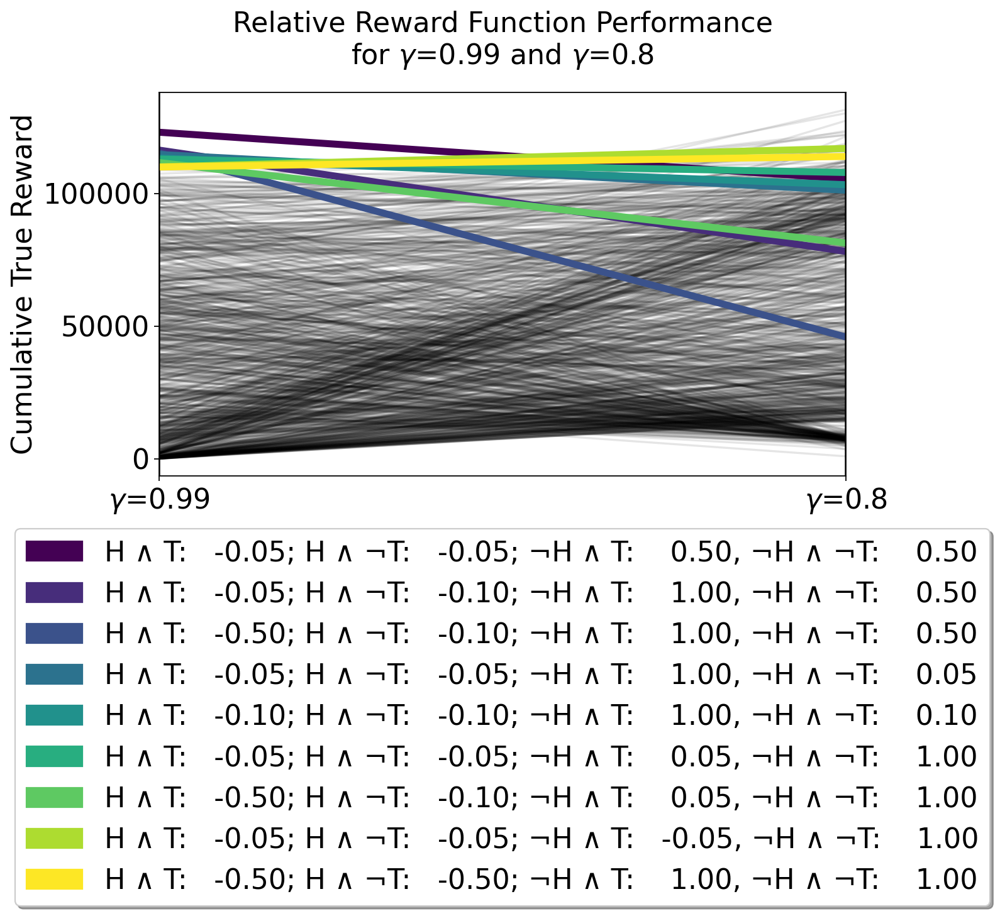

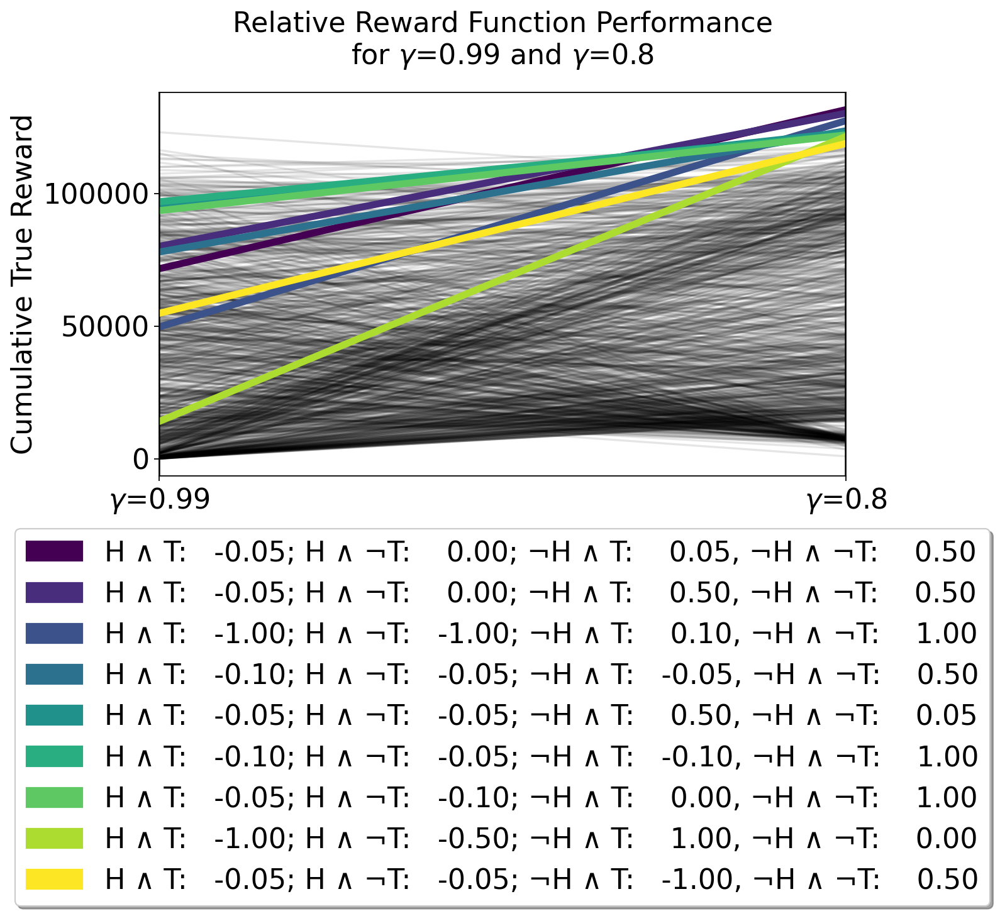

['$\\gamma$=0.99', '$\\gamma$=0.5']
Baseline ;  Gamma=0.5 :  KendalltauResult(correlation=0.042576300640816765, pvalue=0.06521174201158085)


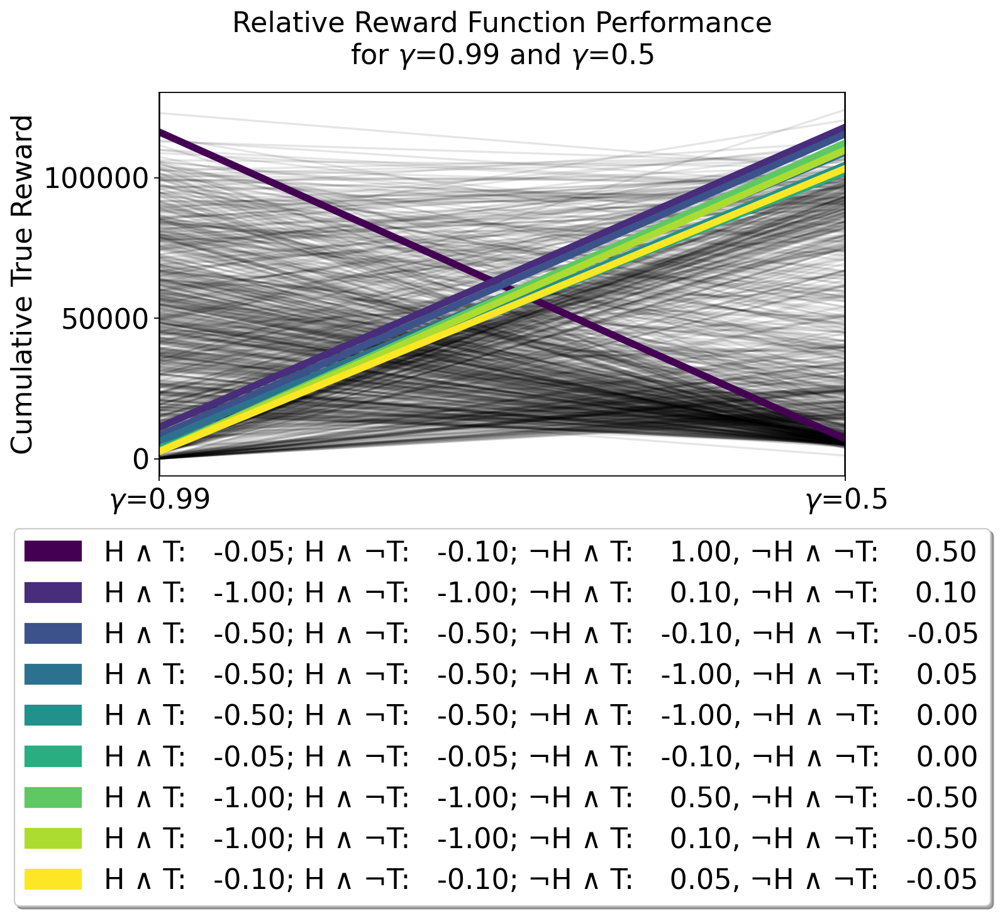

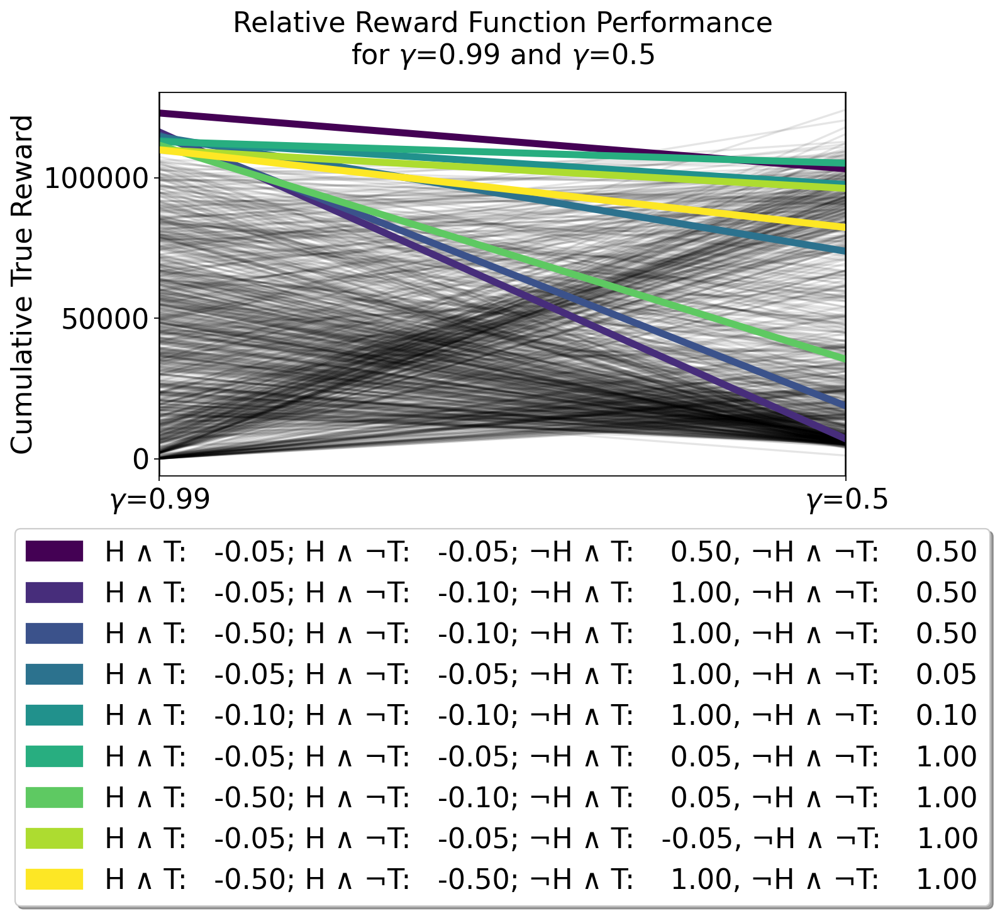

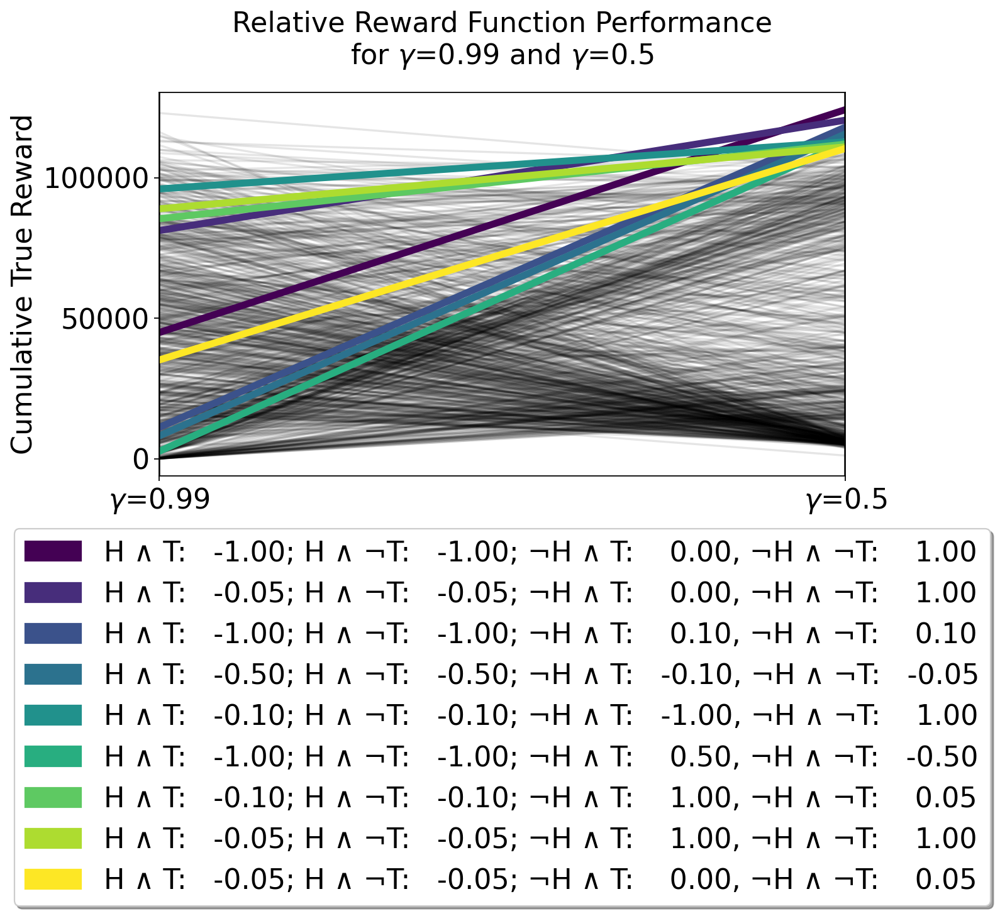

['$\\gamma$=0.8', '$\\alpha$=0.25']
Gamma=0.8 ;  Alpha=0.25 :  KendalltauResult(correlation=0.05941998250404262, pvalue=0.006050833826309645)


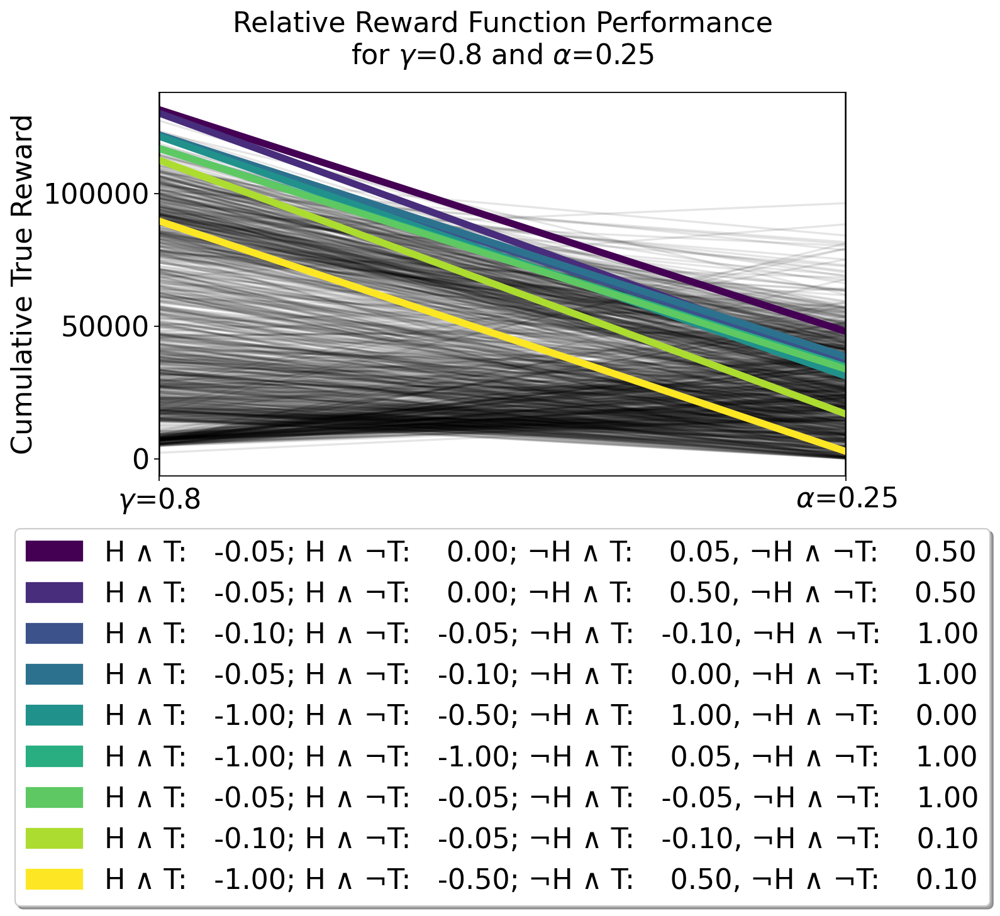

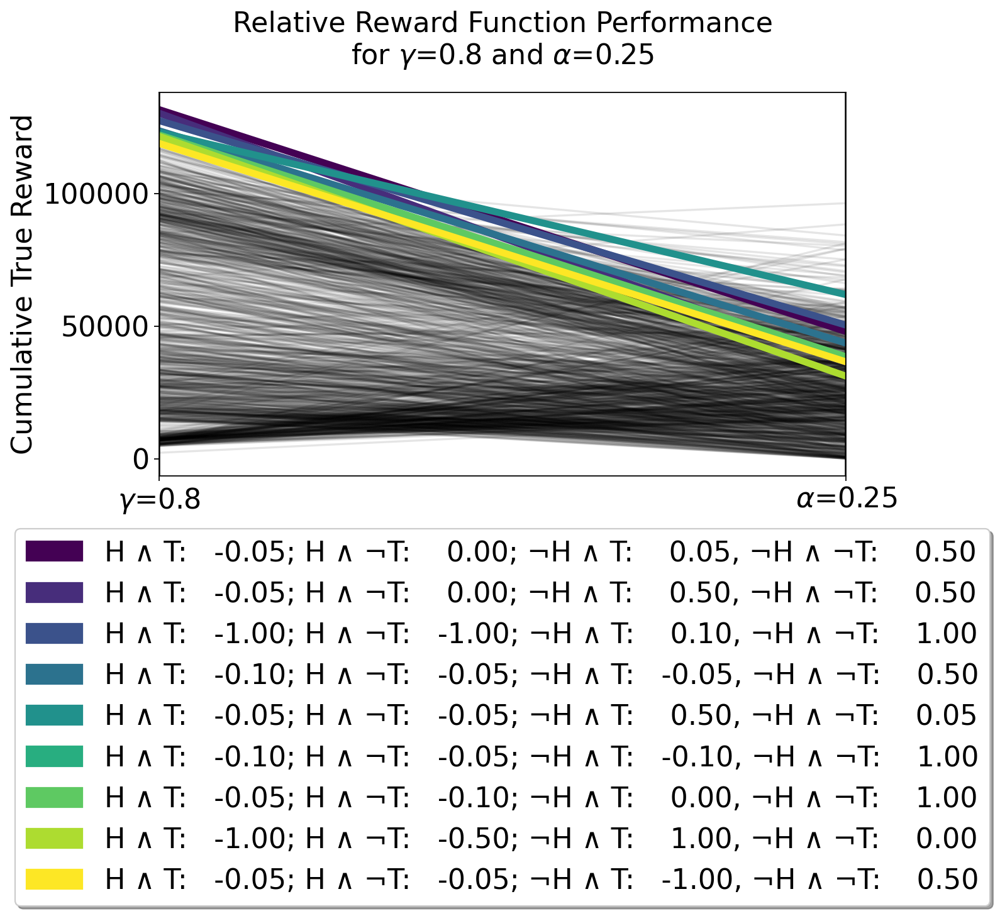

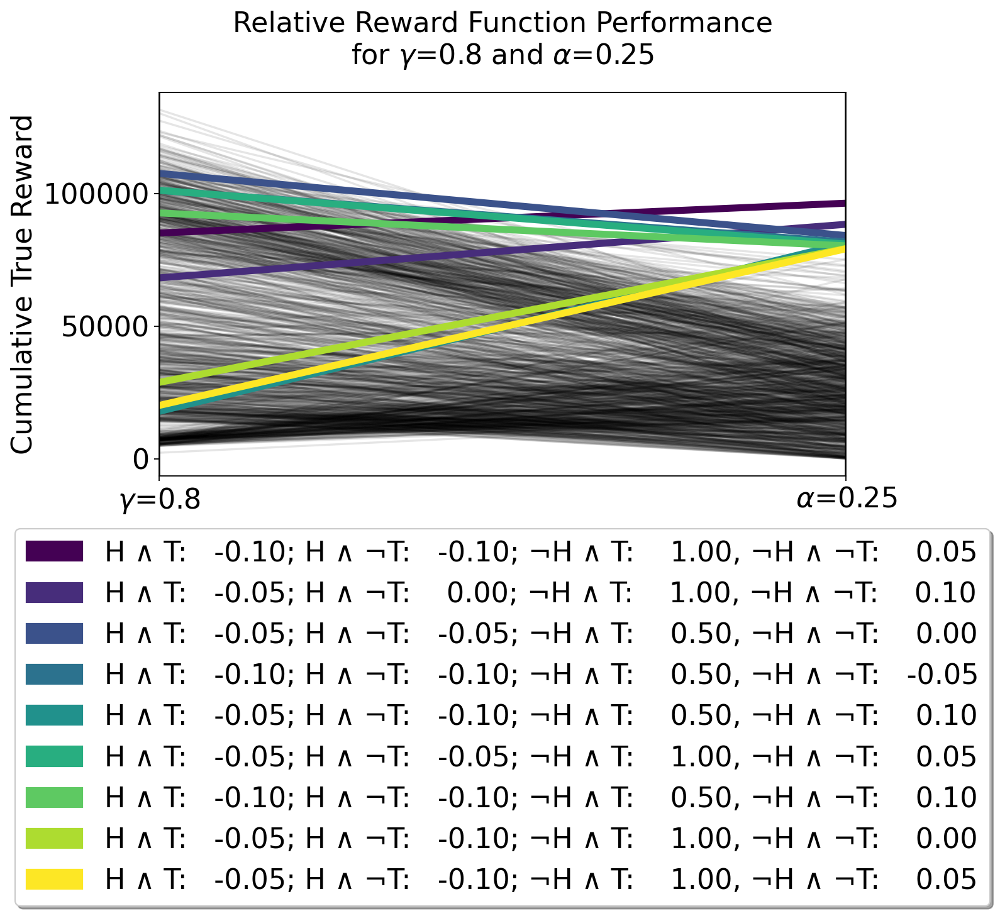

['$\\gamma$=0.8', '$\\gamma$=0.99']
Gamma=0.8 ;  Baseline :  KendalltauResult(correlation=0.06715811611046545, pvalue=0.001929626728481448)


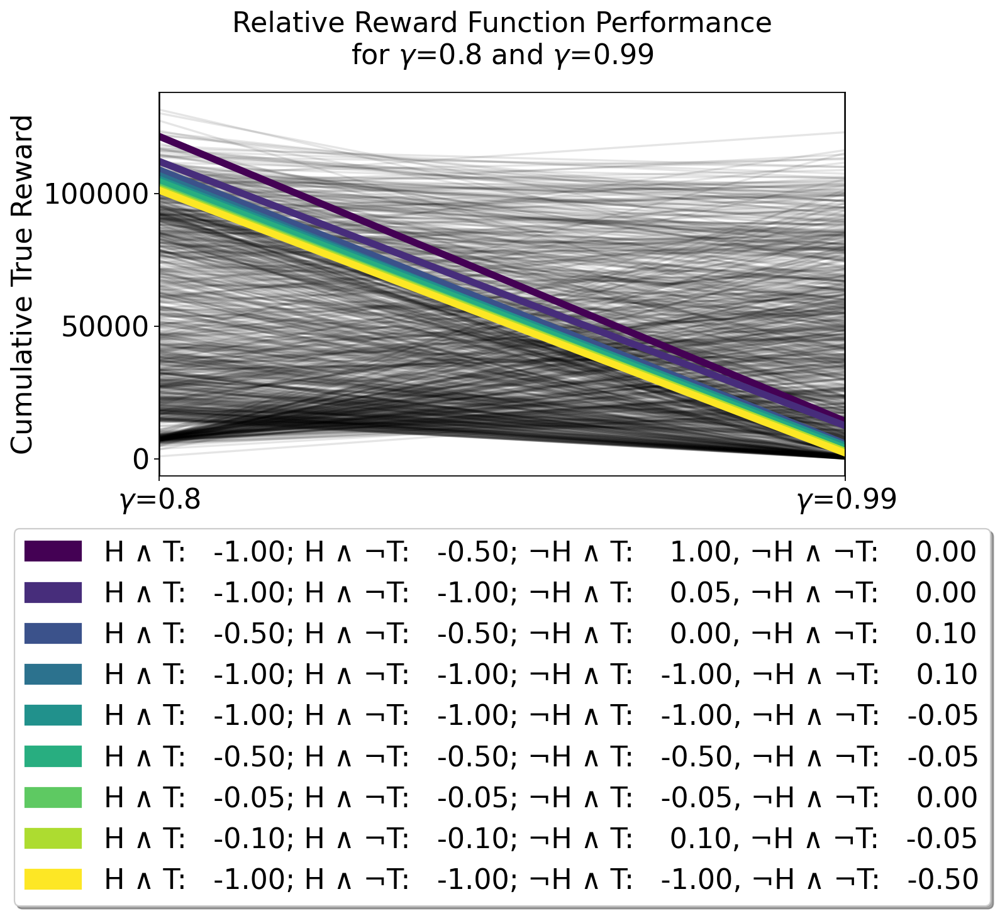

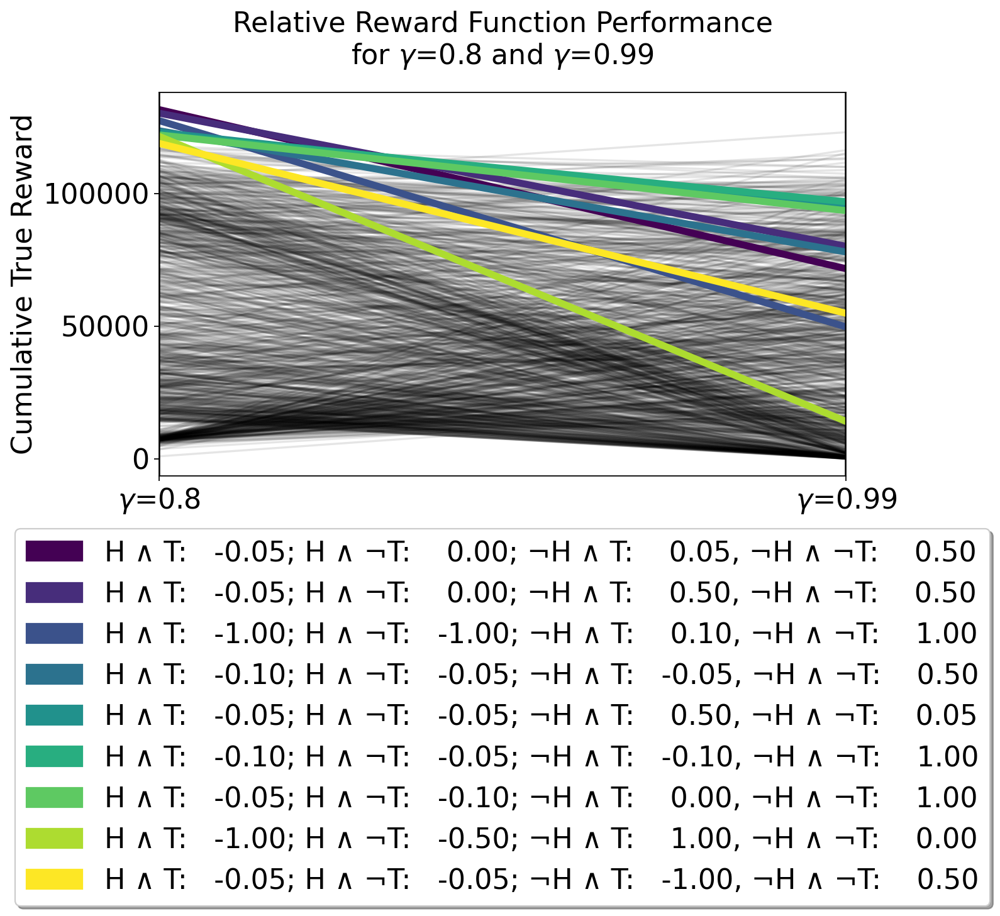

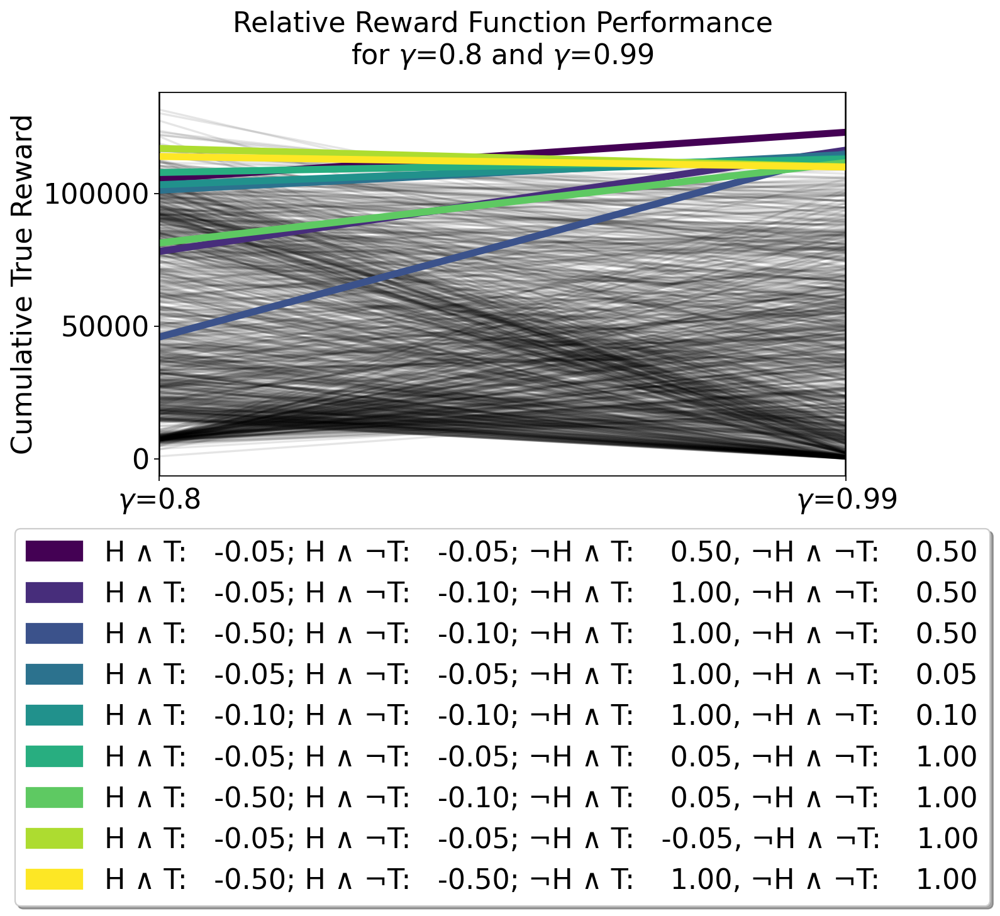

['$\\gamma$=0.8', '$\\gamma$=0.5']
Gamma=0.8 ;  Gamma=0.5 :  KendalltauResult(correlation=0.1164061778557577, pvalue=4.931459287474474e-07)


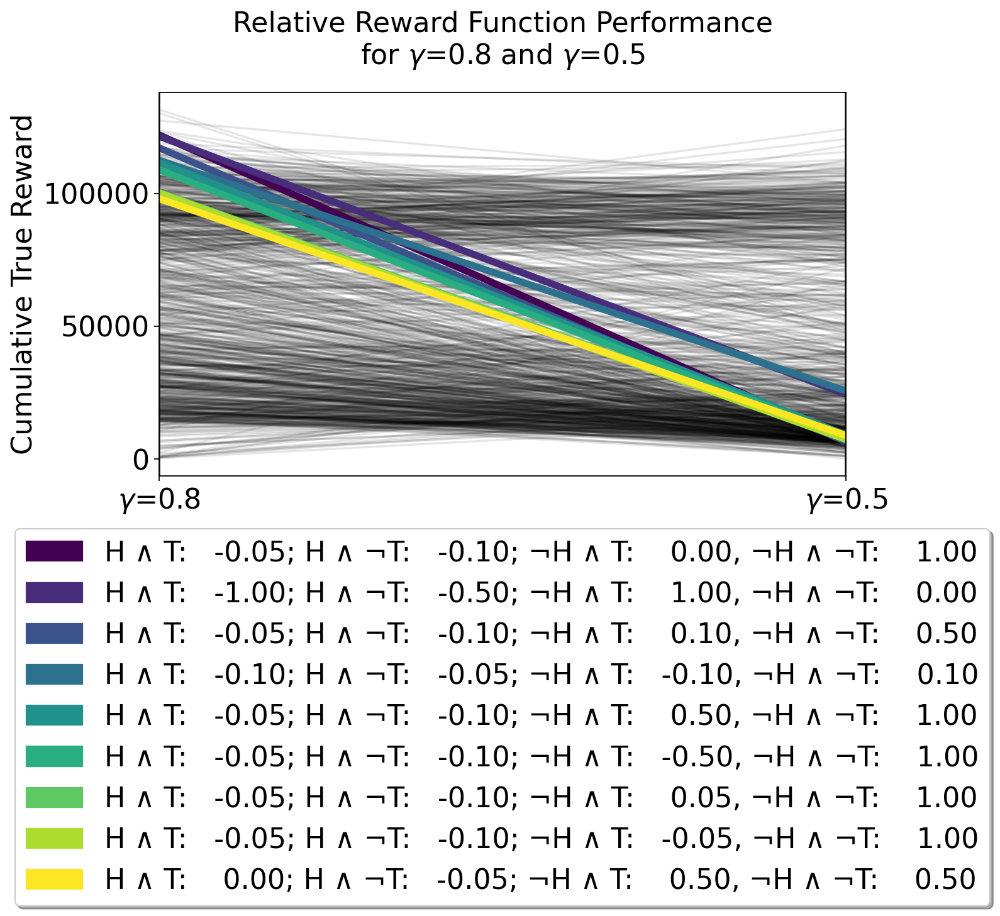

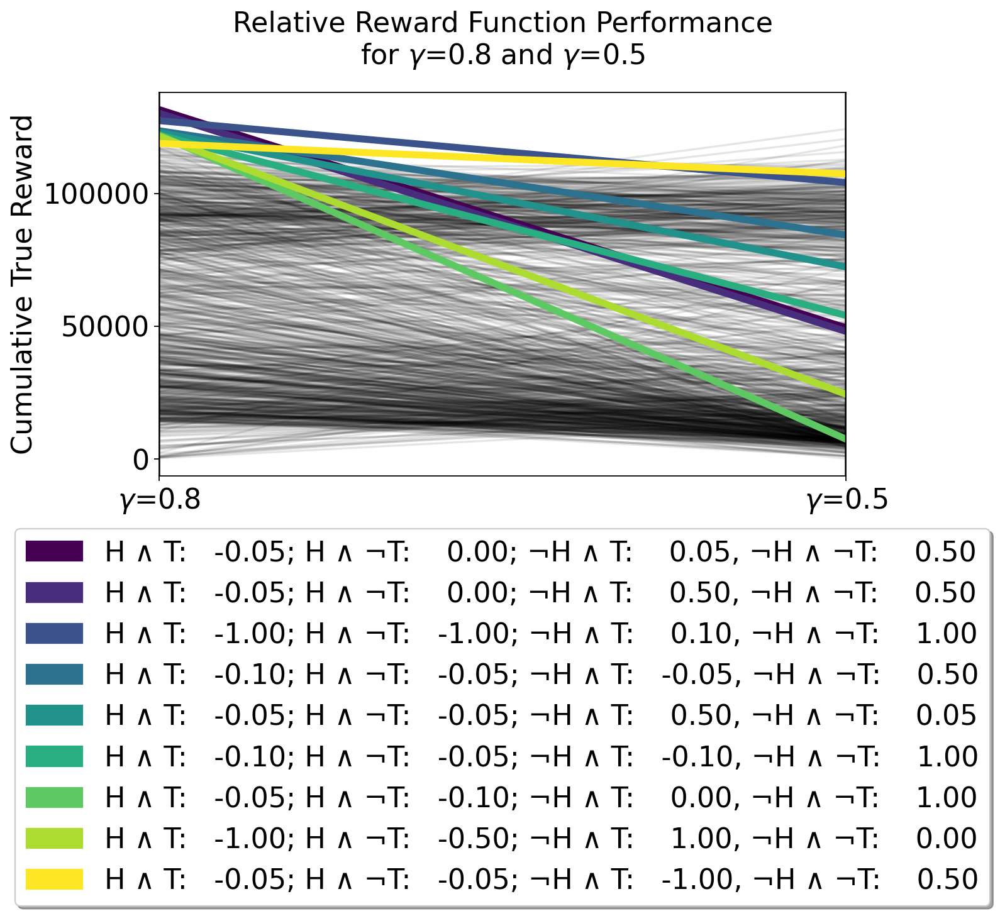

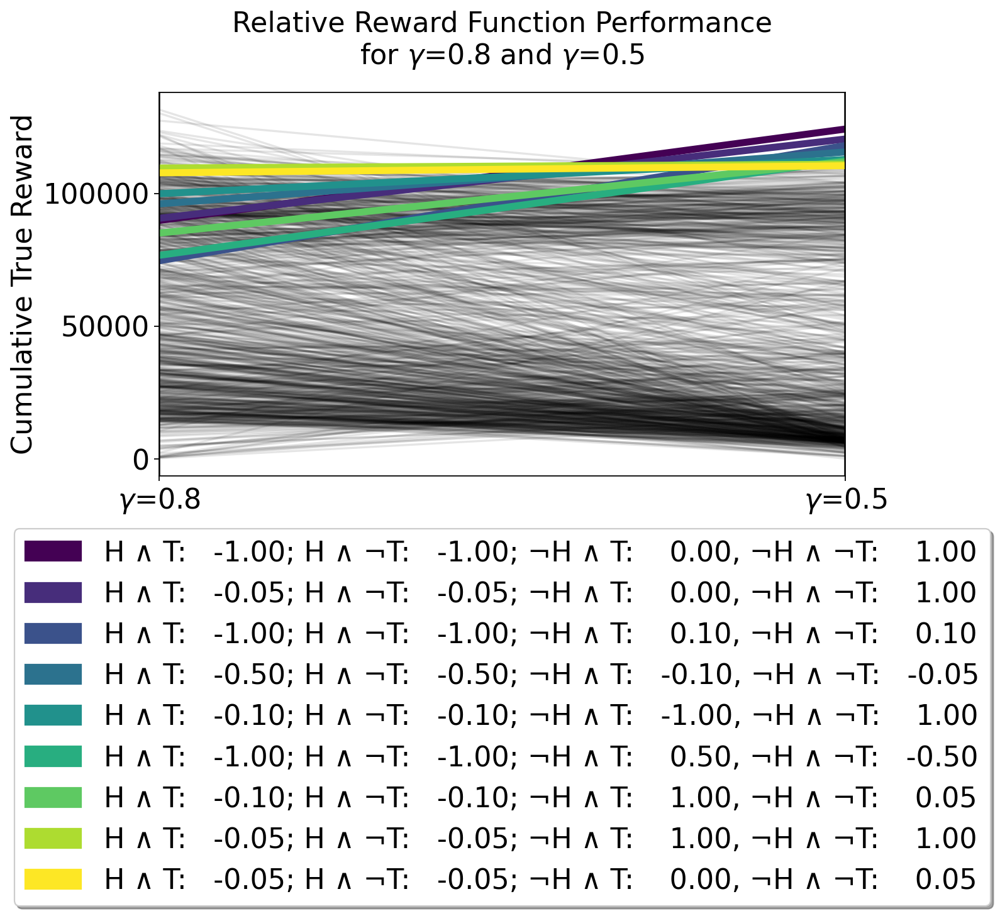

['$\\gamma$=0.5', '$\\alpha$=0.25']
Gamma=0.5 ;  Alpha=0.25 :  KendalltauResult(correlation=0.04888927181608008, pvalue=0.034459711445864204)


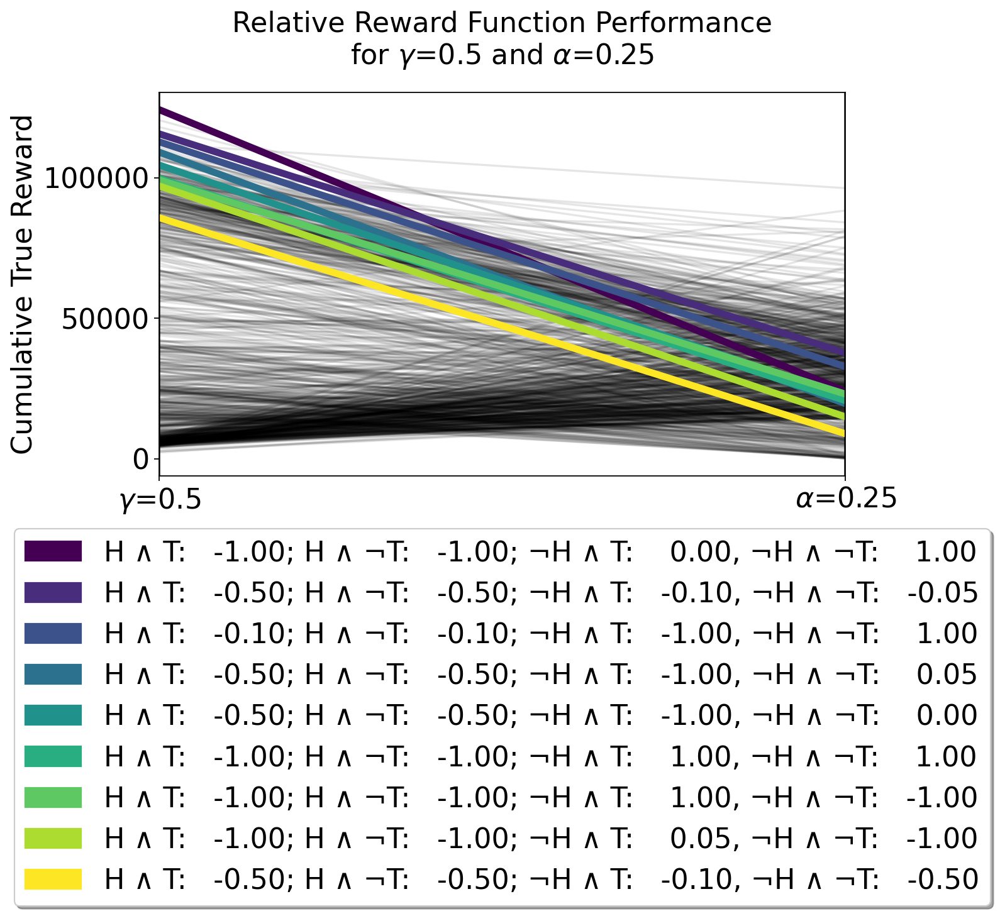

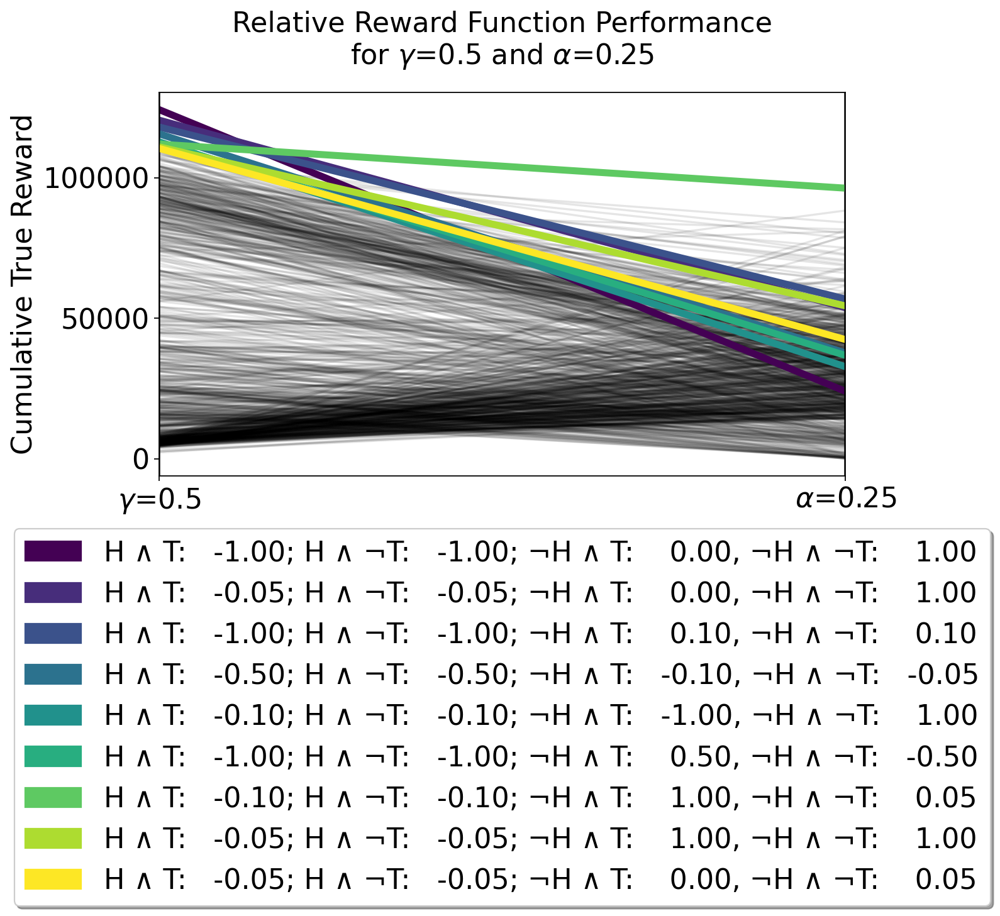

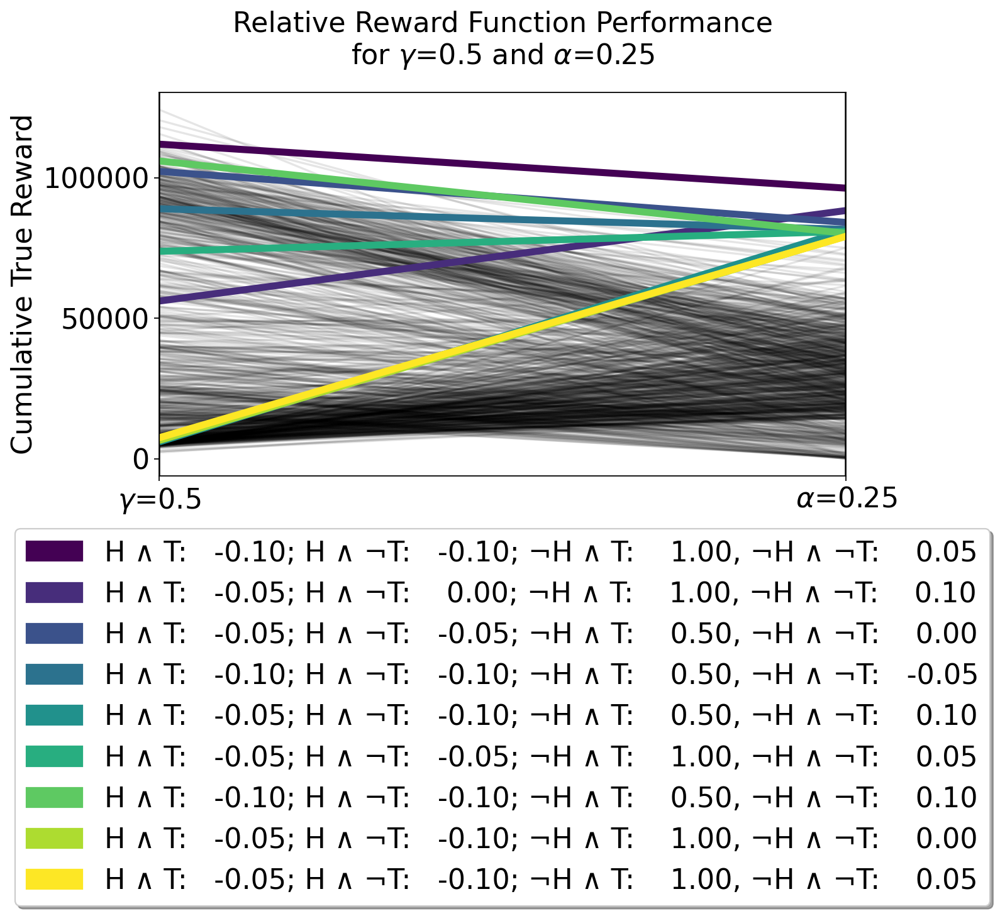

['$\\gamma$=0.5', '$\\gamma$=0.99']
Gamma=0.5 ;  Baseline :  KendalltauResult(correlation=0.042576300640816765, pvalue=0.06521174201158085)


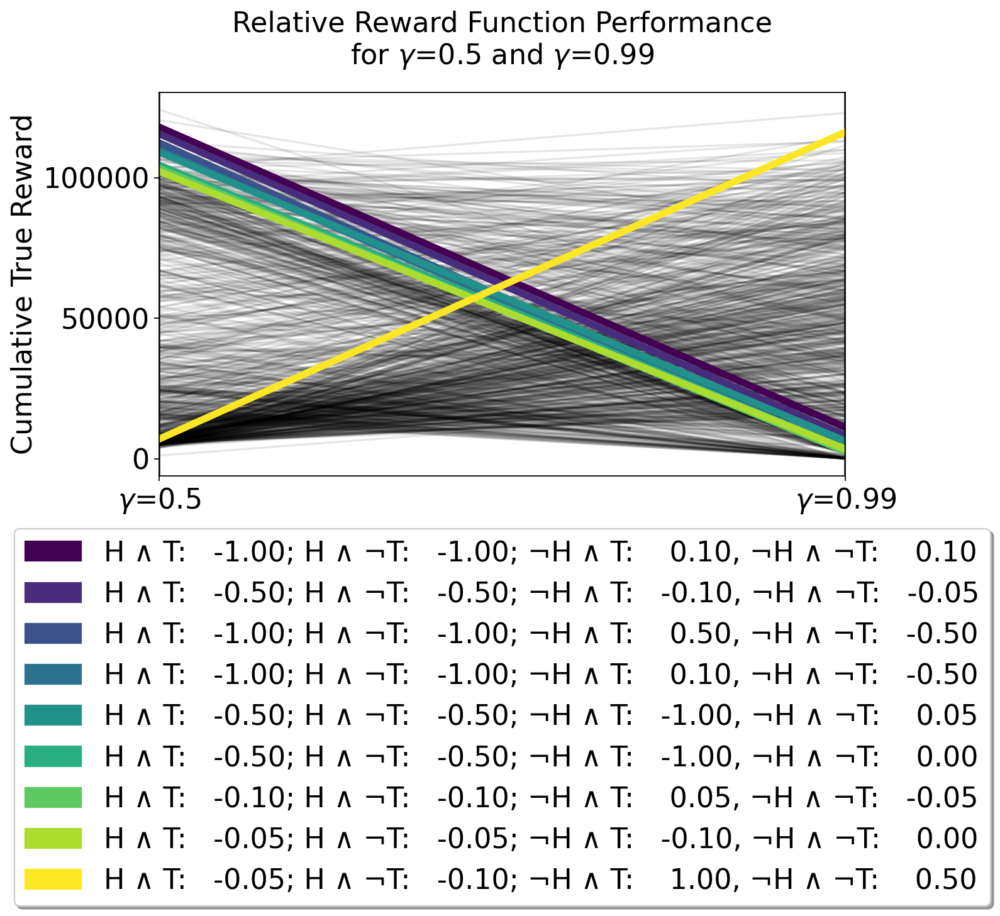

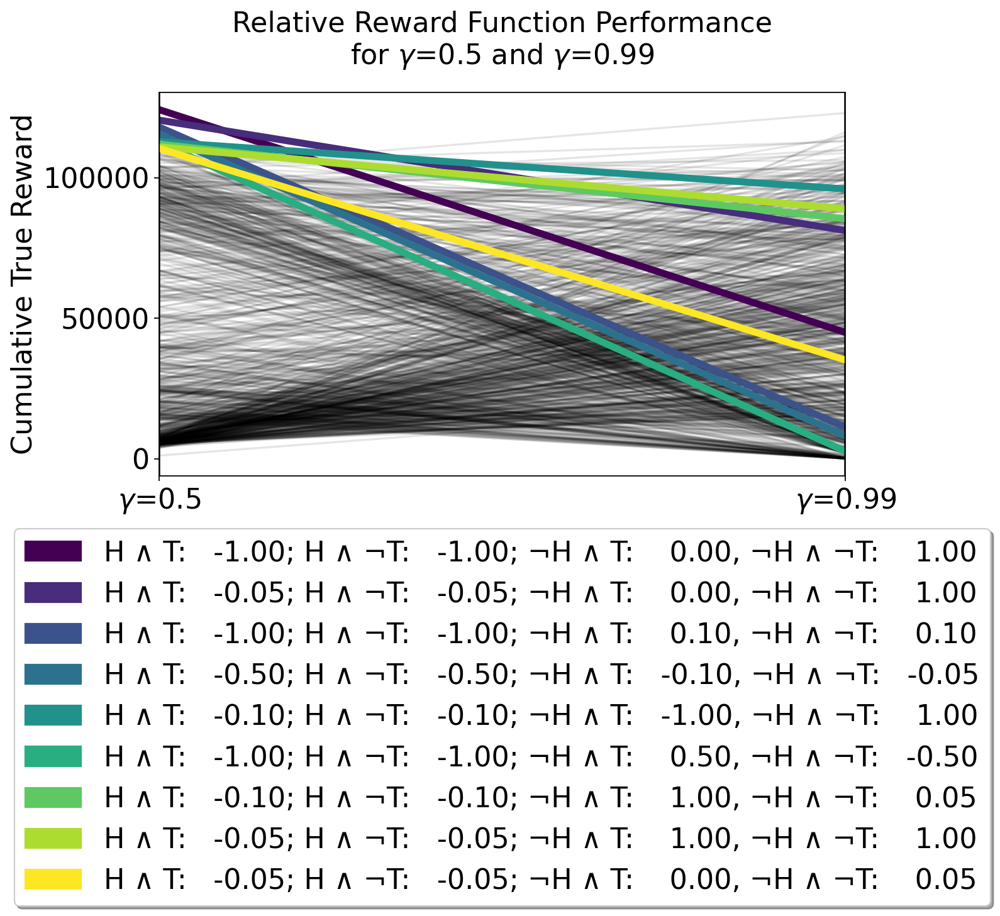

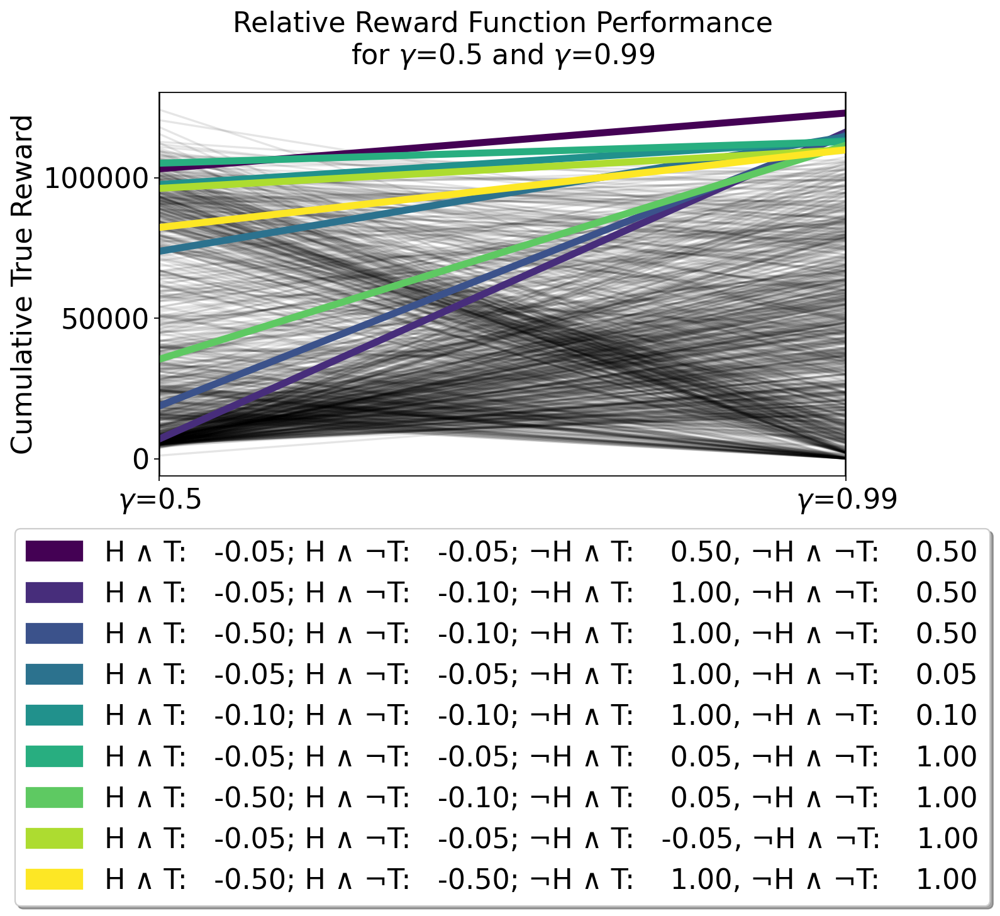

['$\\gamma$=0.5', '$\\gamma$=0.8']
Gamma=0.5 ;  Gamma=0.8 :  KendalltauResult(correlation=0.1164061778557577, pvalue=4.931459287474474e-07)


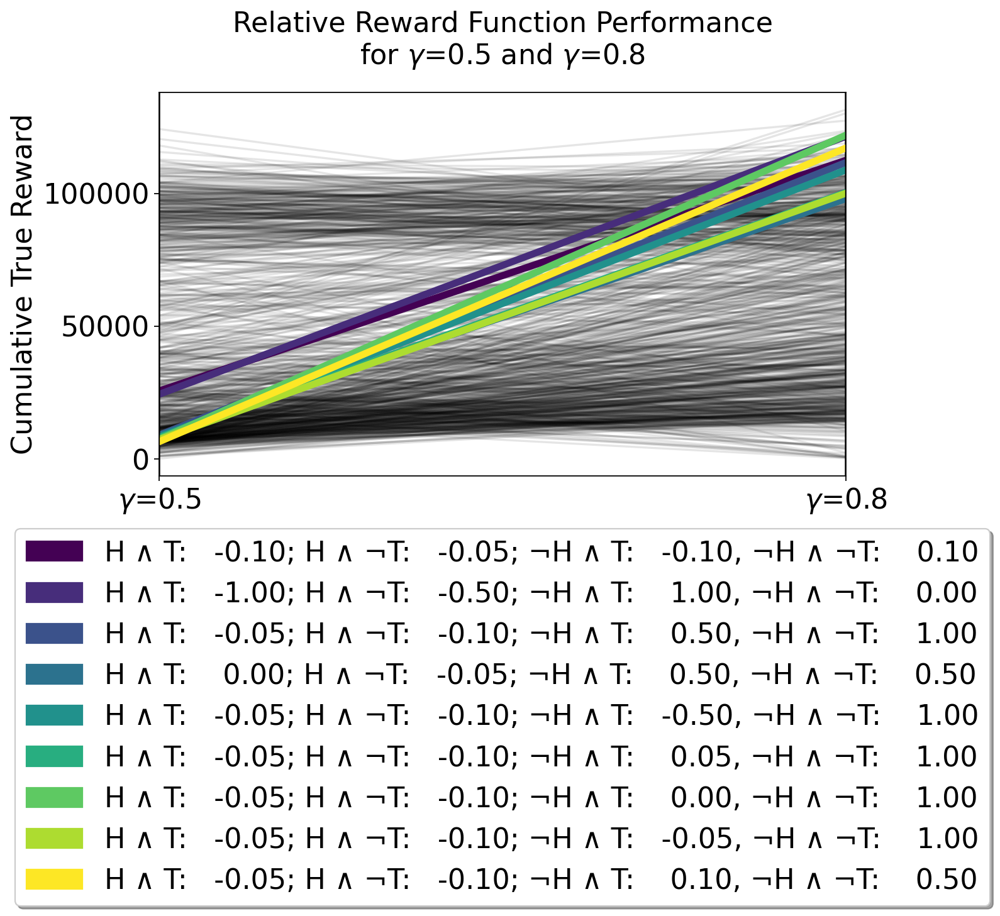

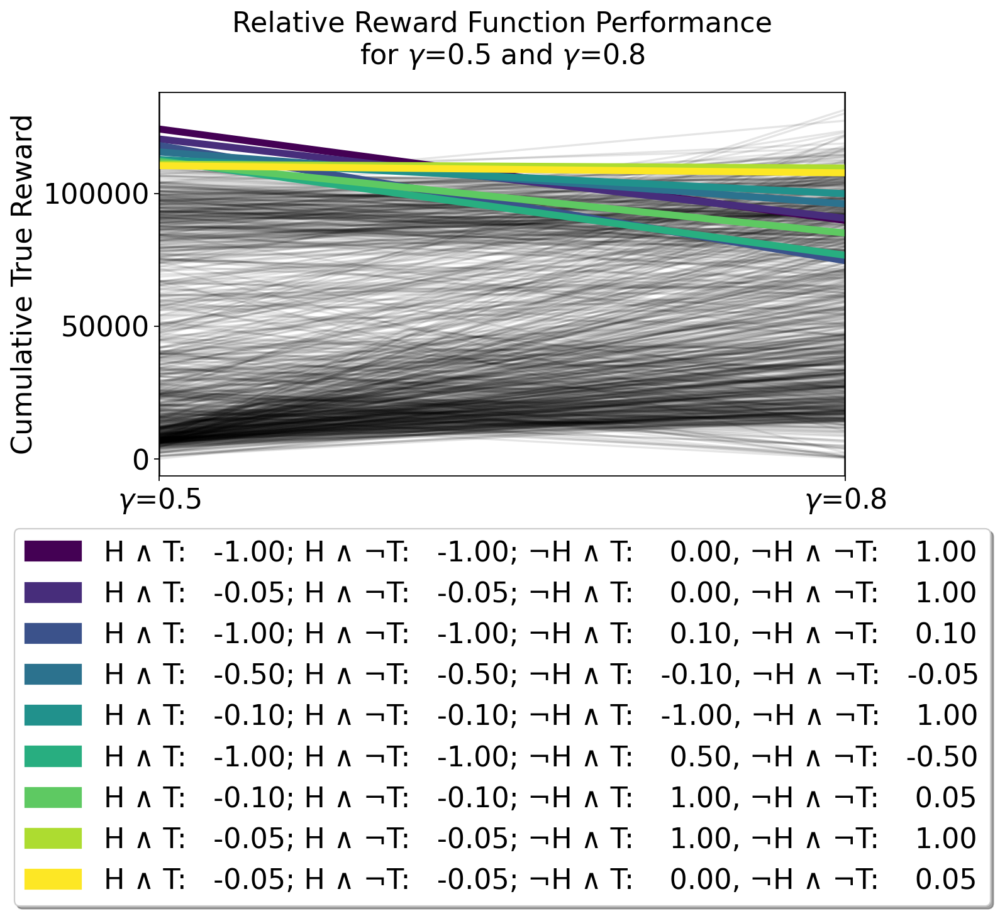

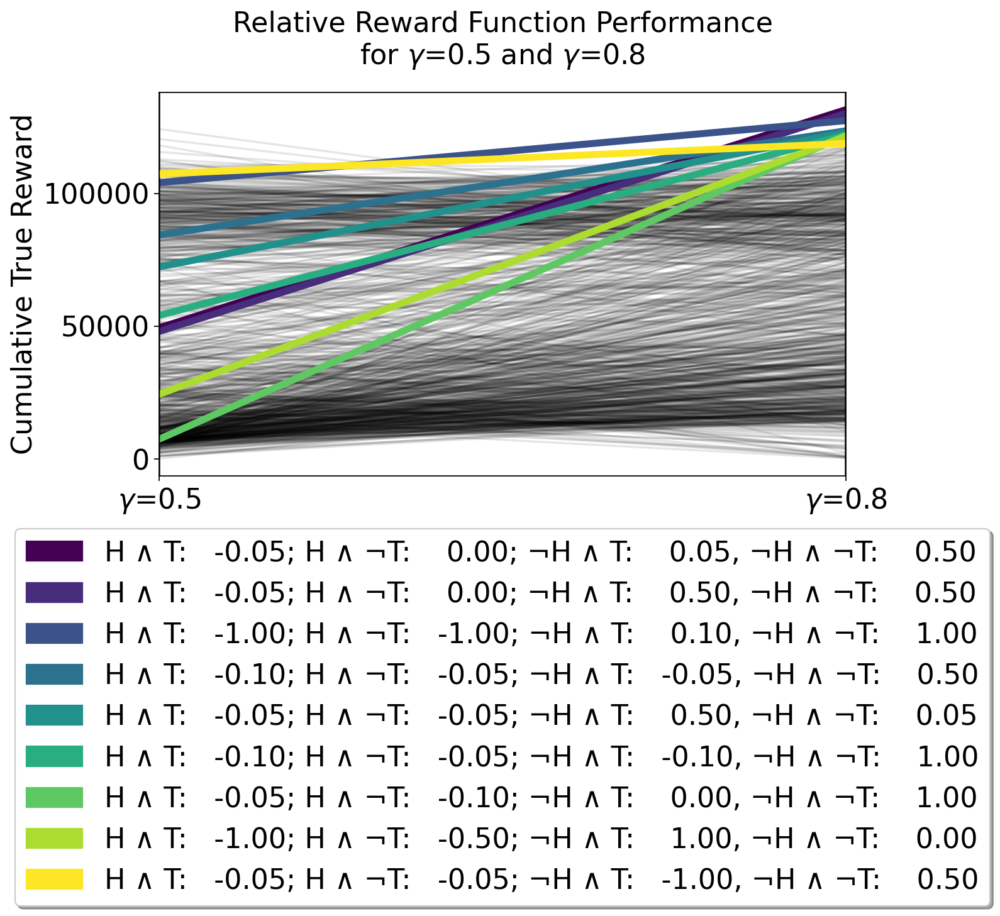

In [30]:
%matplotlib inline  

def label_reward_fn(row):
    def isclose(a, b, rel_tol=1e-04):
        return abs(a-b) <= rel_tol
    reward_fn = [float(elem) for elem in eval(row["Reward Function"])]
  
    if isclose(reward_fn[0], 0.0) and isclose(reward_fn[1],0.0):
        return "Simple Fitness"
    elif isclose(reward_fn[0], reward_fn[1]) and isclose(reward_fn[2], reward_fn[3]):
        return "Fitness-based"
    else:
        return "Other"

cumulative_df = li[0]
join_cols = ["Reward Function"]
color_cm = plt.get_cmap("viridis")
y_lim=None
if DIRS_LOCS == DEEP_LOCS:
    y_lim = [0,360000]


for i in range(1, len(DIRS)):
    cumulative_df = cumulative_df.merge(li[i], on=join_cols)
    
for combination in list(itertools.permutations(DIRS,2)):    
    cumulative_df['abs_diff_{}'.format(combination)] = abs(cumulative_df[combination[0]] - cumulative_df[combination[1]])
cumulative_df.to_csv("cumulative_df")
    
for combination in list(itertools.permutations(DIRS,2)):    
    labels = []
    if combination[0] == "Baseline":
        if "Alpha" in combination[1]:
            labels.append("$\\alpha$=0.05")
        elif "Gamma" in combination[1]:
            labels.append("$\gamma$=0.99")
        else:
            labels.append(combination[0].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
        labels.append(combination[1].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
    elif combination[1] == "Baseline":
        labels.append(combination[0].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
        if "Alpha" in combination[0]:
            labels.append("$\\alpha$=0.05")
        elif "Gamma" in combination[0]:
            labels.append("$\gamma$=0.99")
        else:
            labels.append(combination[1].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
    else:
        labels.append(combination[0].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
        labels.append(combination[1].replace("Gamma", "$\gamma$").replace("Alpha", "$\\alpha$"))
    print (labels)
    
    kendalls_tau_value = compute_kendalls_tau_df(df=cumulative_df, axes=combination)
    print(combination[0], "; ", combination[1], ": ", kendalls_tau_value)
    
    get_max_diff_reward_fns(df=cumulative_df, axes=combination) 
    get_max_reward_fns(df=cumulative_df, axis=combination[0])
    get_max_reward_fns(df=cumulative_df, axis=combination[1])

    plot_parallel_coordinate(df=cumulative_df, 
                             plotting_axes=combination,
                             highlight='abs_diff_{}'.format(combination),
                             labels=labels,
                             y_lim=y_lim)
    plot_parallel_coordinate(df=cumulative_df, 
                         plotting_axes=combination,
                         highlight=combination[0],
                         labels=labels,
                         y_lim=y_lim)
    plot_parallel_coordinate(df=cumulative_df, 
                         plotting_axes=combination,
                         highlight=combination[1],
                         labels=labels,
                         y_lim=y_lim)